In [7]:
!{sys.executable} -m pip install -v "opencv-python==4.5.1.48"
!{sys.executable} -m pip install matplotlib

Using pip 21.1.2 from d:\projects\put\computer-vision-project-2\venv\lib\site-packages\pip (python 3.7)
Non-user install because user site-packages disabled
Created temporary directory: C:\Users\aszcz\AppData\Local\Temp\pip-ephem-wheel-cache-7chdd51c
Created temporary directory: C:\Users\aszcz\AppData\Local\Temp\pip-req-tracker-sppuonhp
Initialized build tracking at C:\Users\aszcz\AppData\Local\Temp\pip-req-tracker-sppuonhp
Created build tracker: C:\Users\aszcz\AppData\Local\Temp\pip-req-tracker-sppuonhp
Entered build tracker: C:\Users\aszcz\AppData\Local\Temp\pip-req-tracker-sppuonhp
Created temporary directory: C:\Users\aszcz\AppData\Local\Temp\pip-install-cmfq3bas
Created temporary directory: C:\Users\aszcz\AppData\Local\Temp\pip-unpack-spd_ebp2
Removed build tracker: 'C:\\Users\\aszcz\\AppData\\Local\\Temp\\pip-req-tracker-sppuonhp'


In [3]:
import cv2 as cv
from matplotlib import pyplot as plt

from src.pipeline_functions import straighten_page, remove_grid_lines


Load image

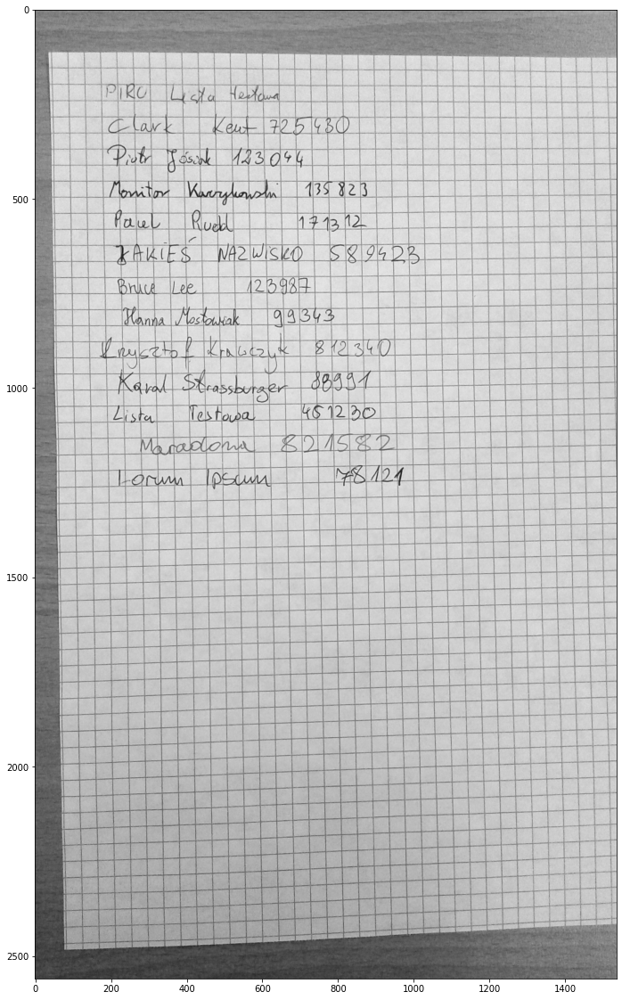

In [4]:
image = cv.imread('data/img_2.jpg', cv.IMREAD_GRAYSCALE)

plt.figure(figsize=(20, 20))
plt.imshow(image, cmap='gray')
plt.show()

Straighten image

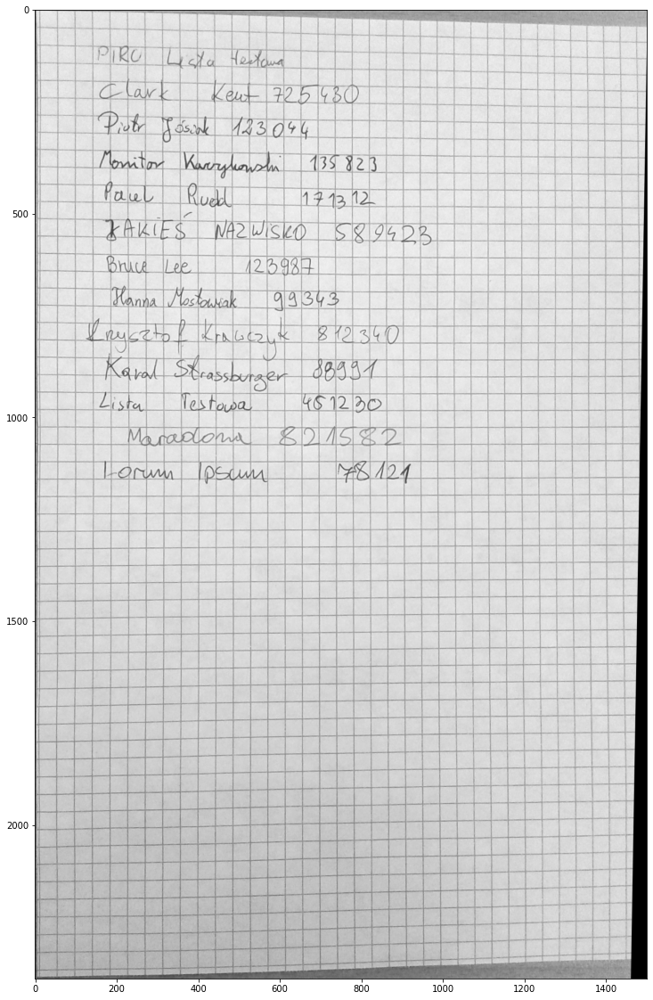

In [5]:
image_straightened = straighten_page(image)

plt.figure(figsize=(20, 20))
plt.imshow(image_straightened, cmap='gray')
plt.show()


Remove grid lines

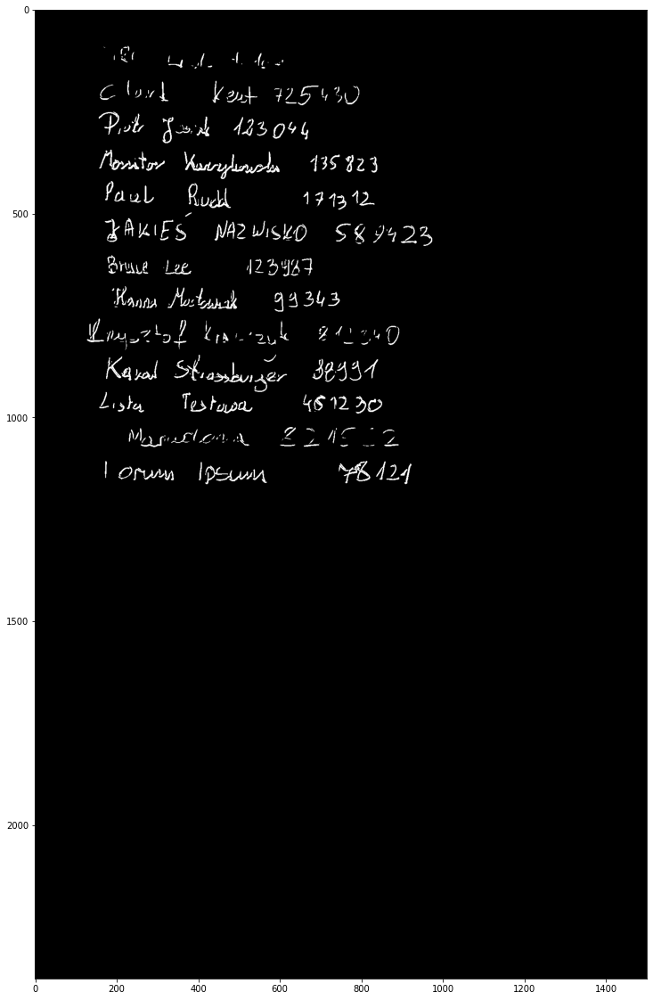

In [6]:
image_no_grid = remove_grid_lines(image_straightened)

plt.figure(figsize=(20, 20))
plt.imshow(image_no_grid, cmap='gray')
plt.show()

Test on all images

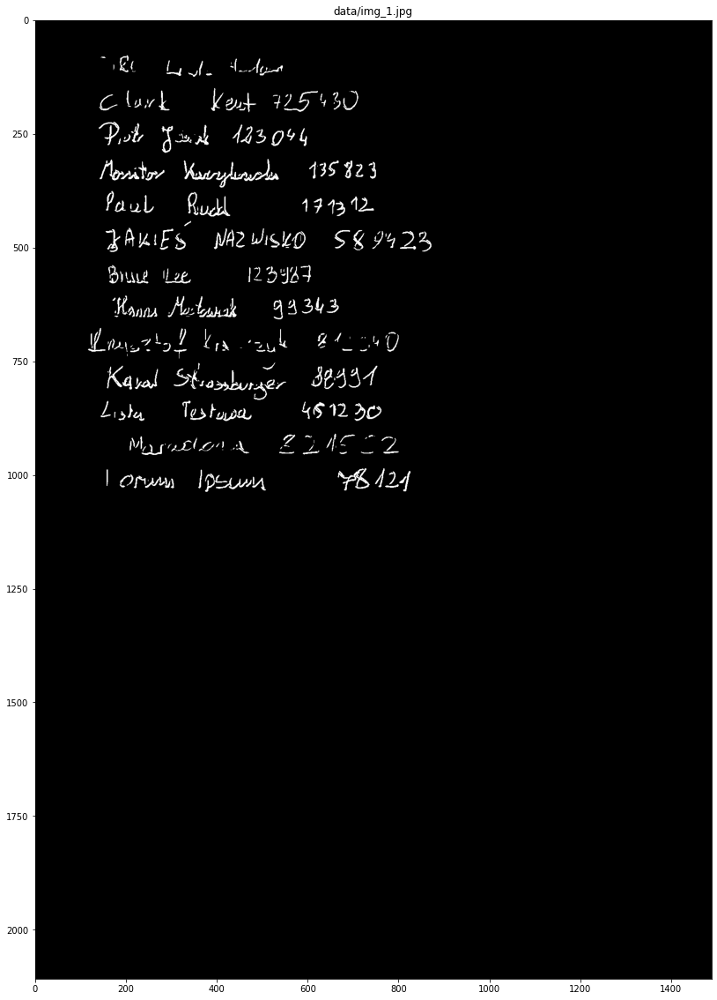

Took : 25.851s


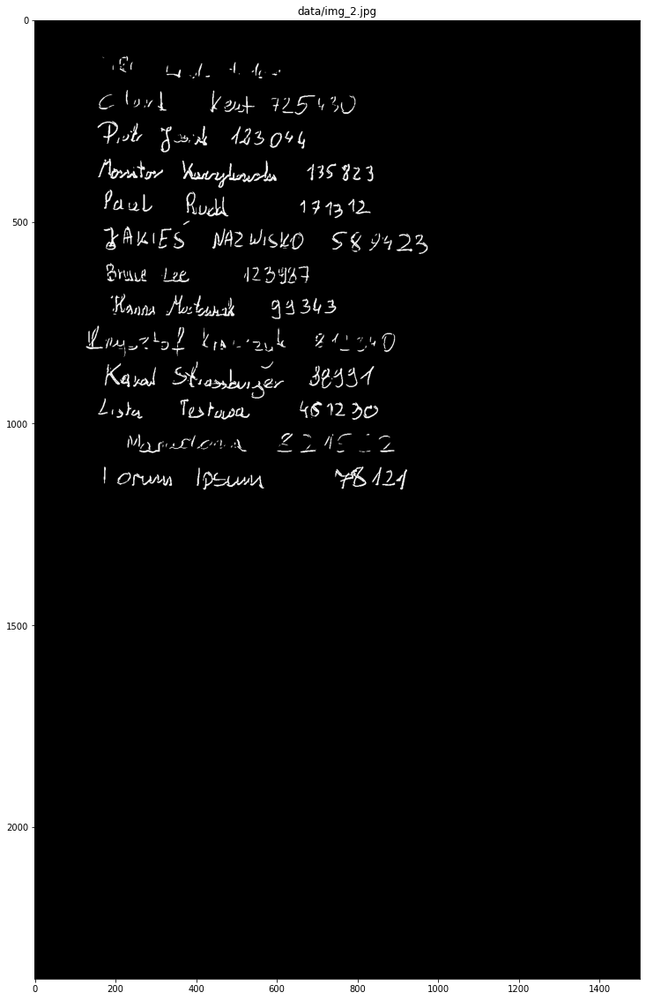

Took : 35.037s


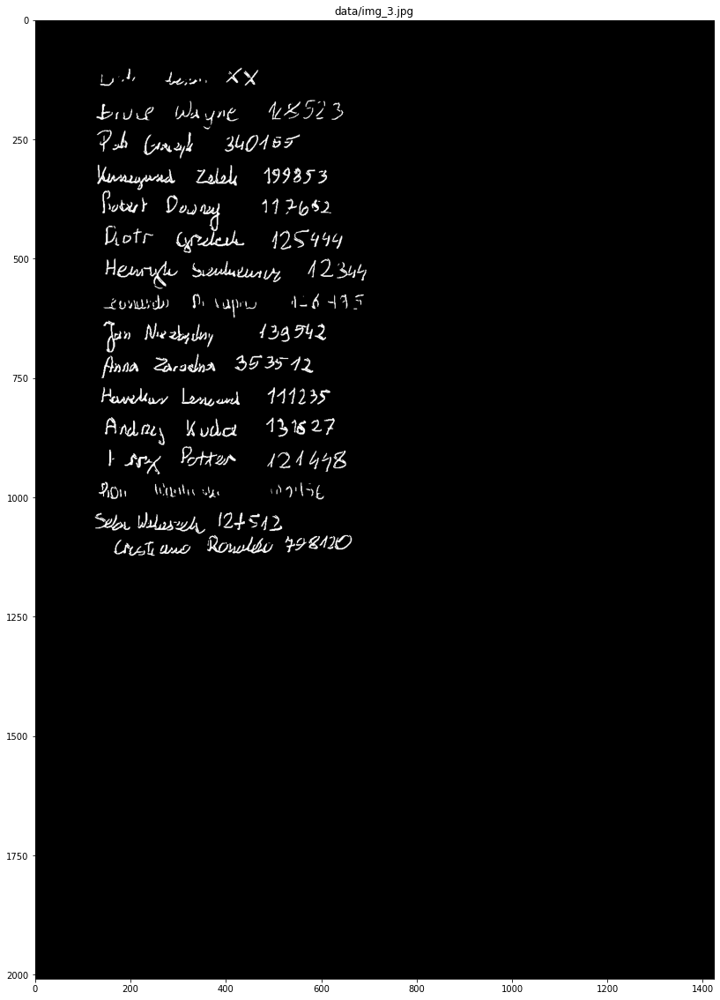

Took : 17.678s


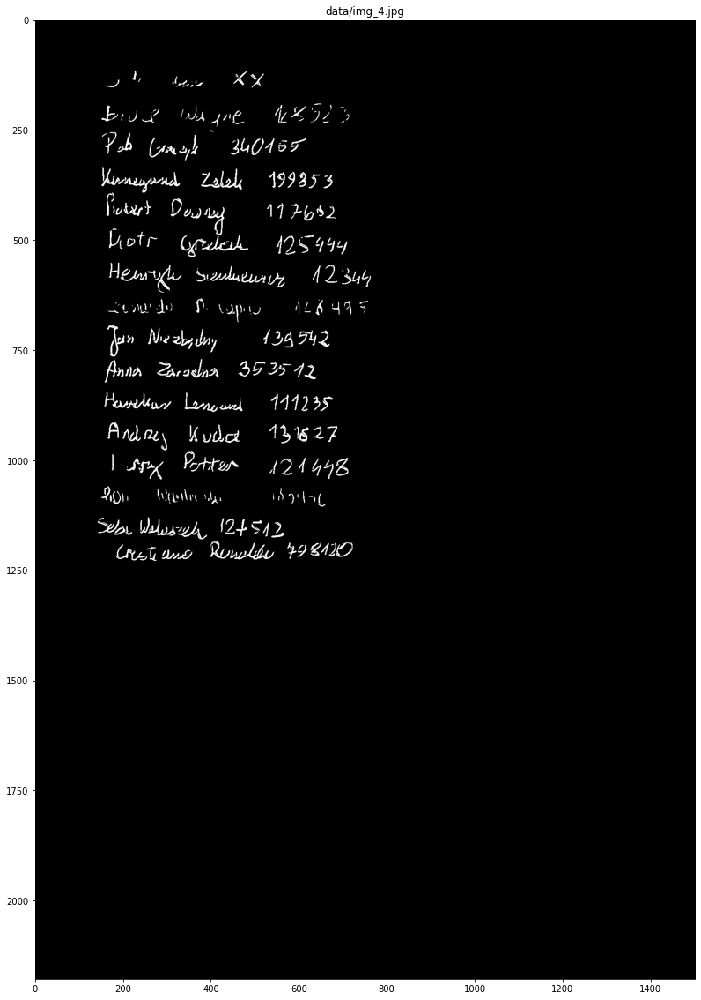

Took : 27.662s


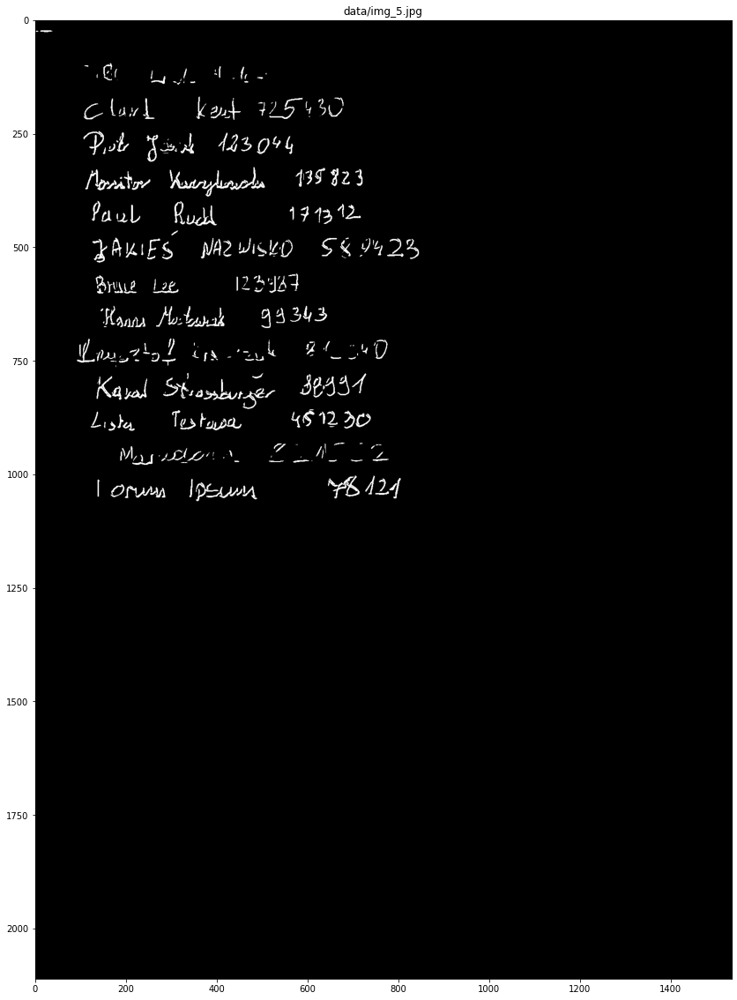

Took : 19.958s


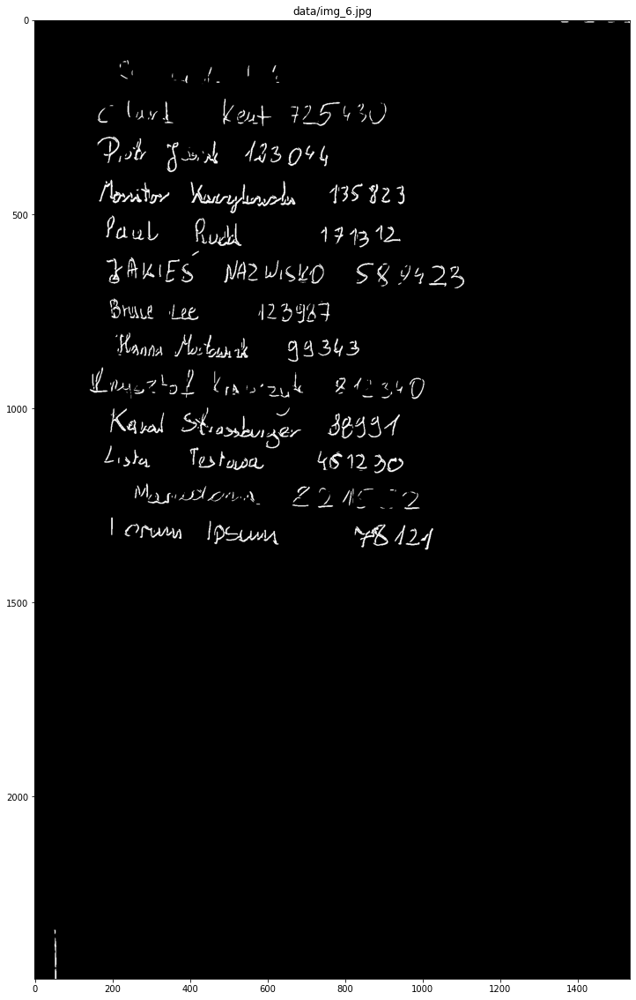

Took : 37.718s


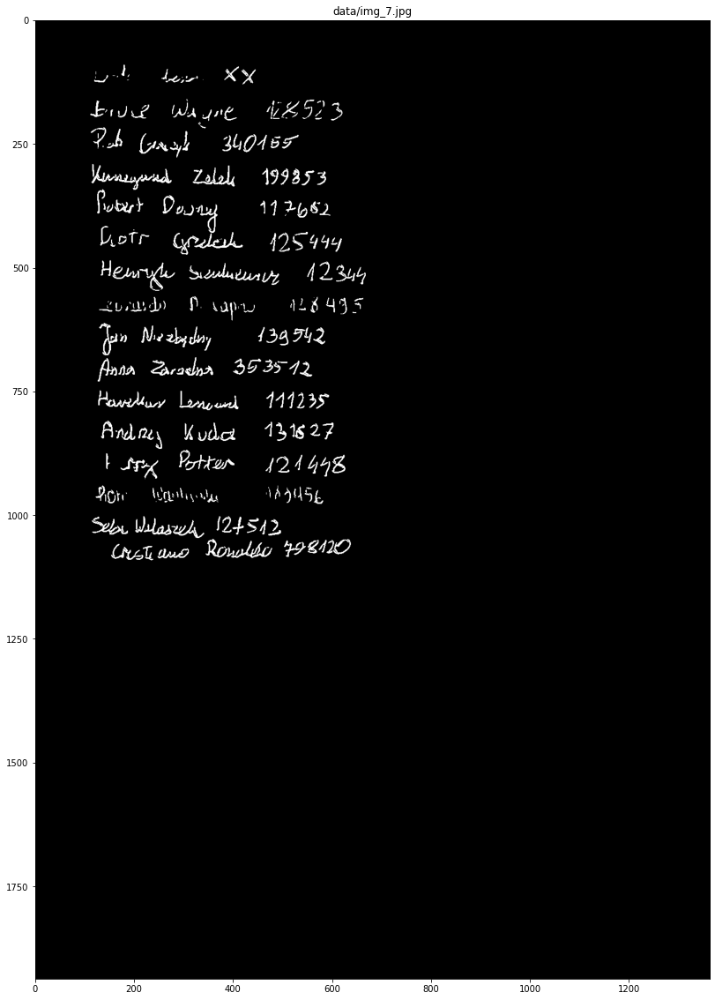

Took : 12.205s


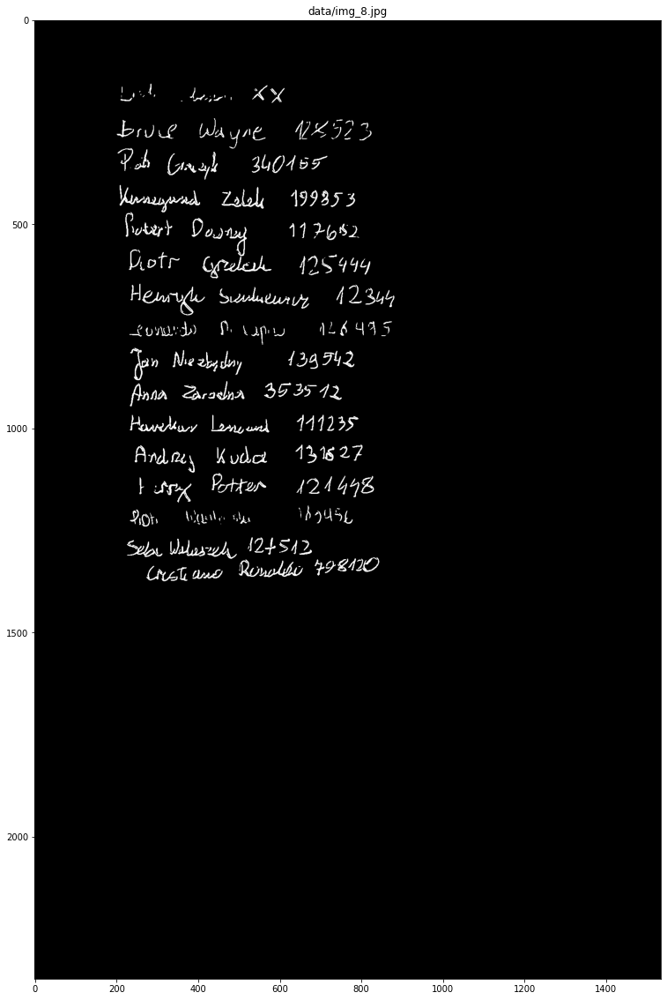

Took : 21.921s


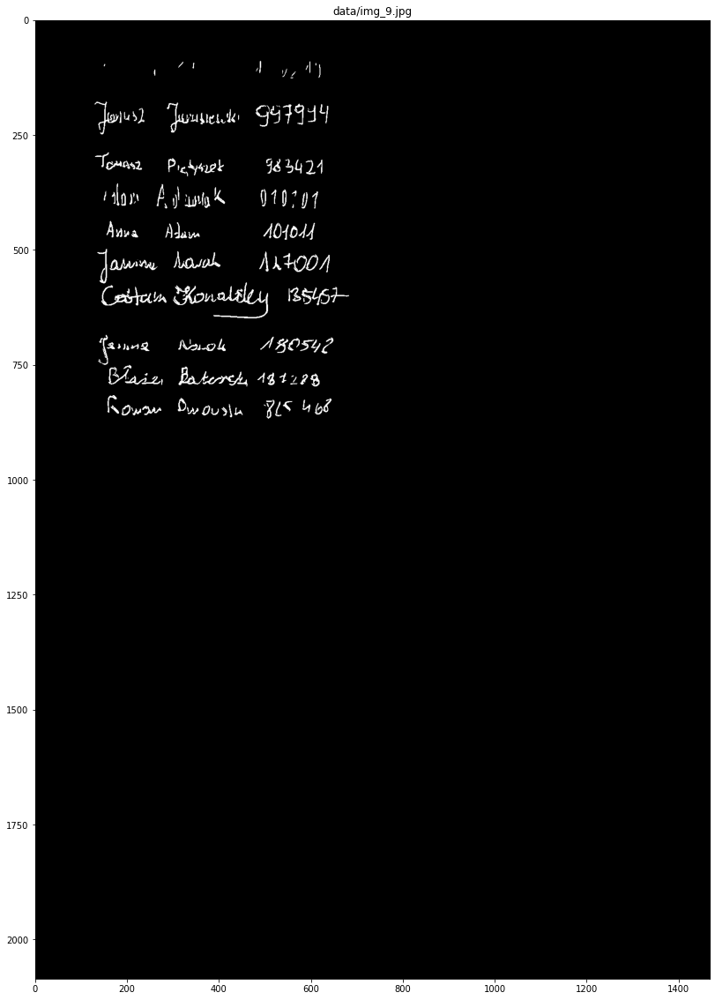

Took : 12.893s


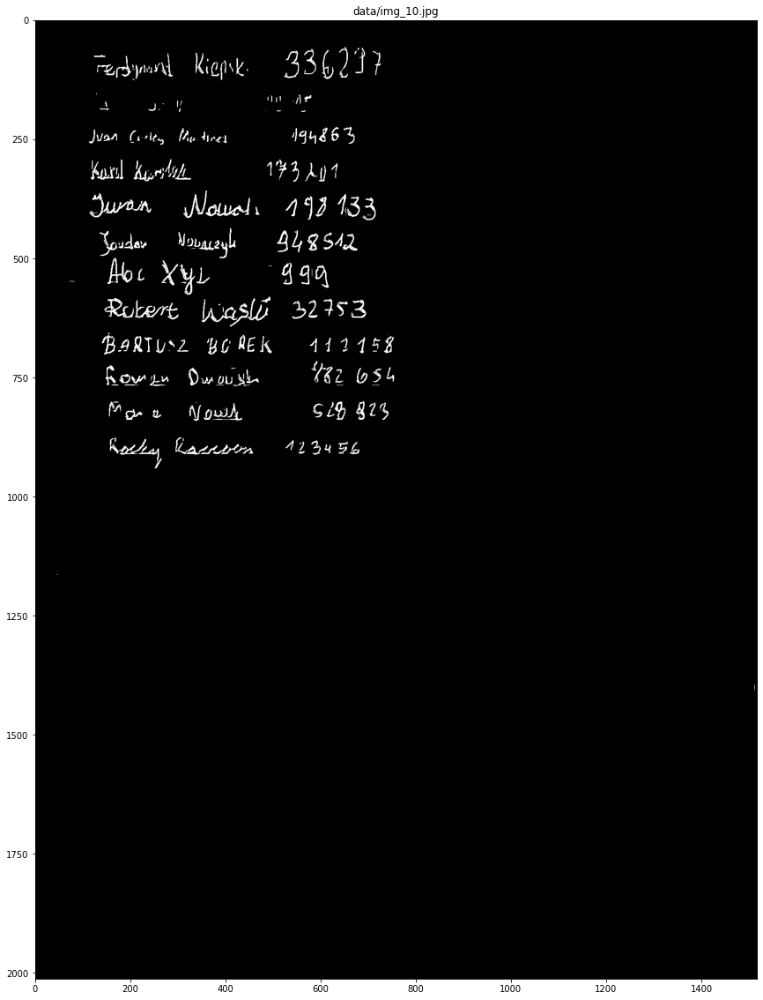

Took : 19.83s


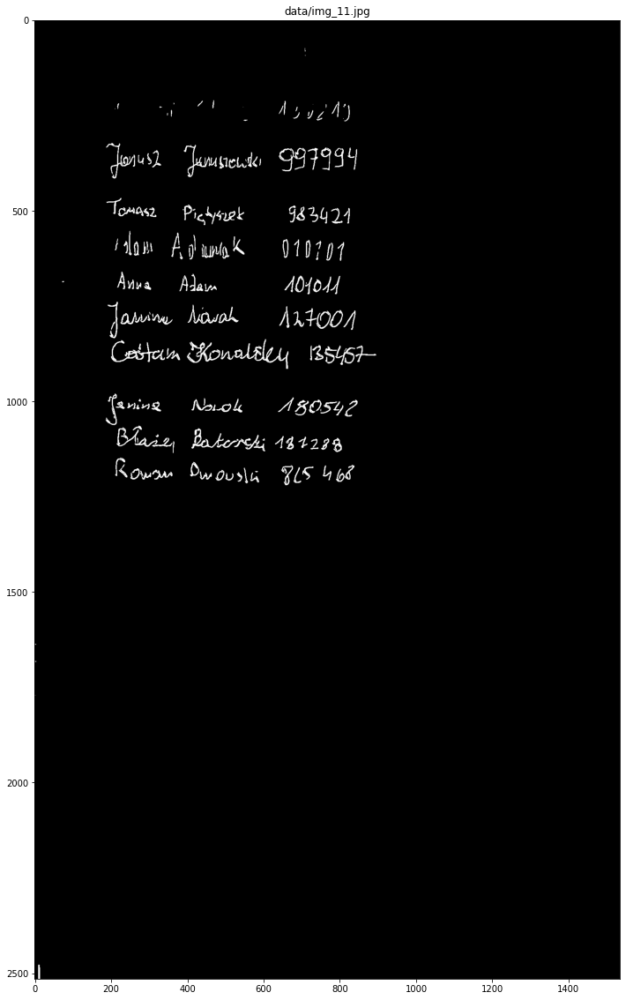

Took : 14.99s


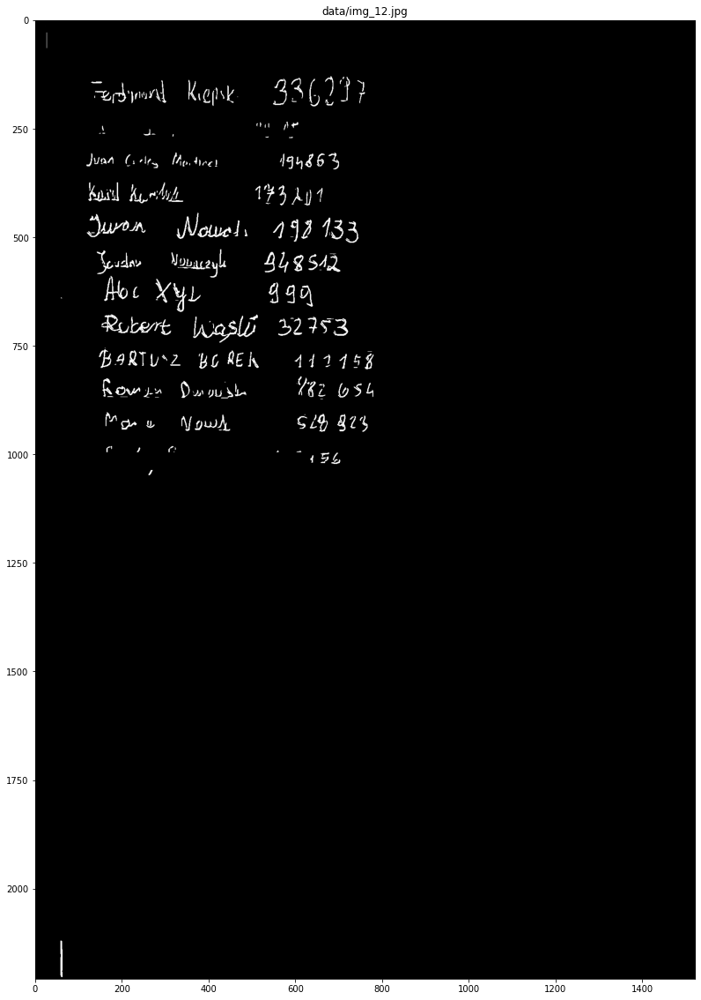

Took : 21.57s


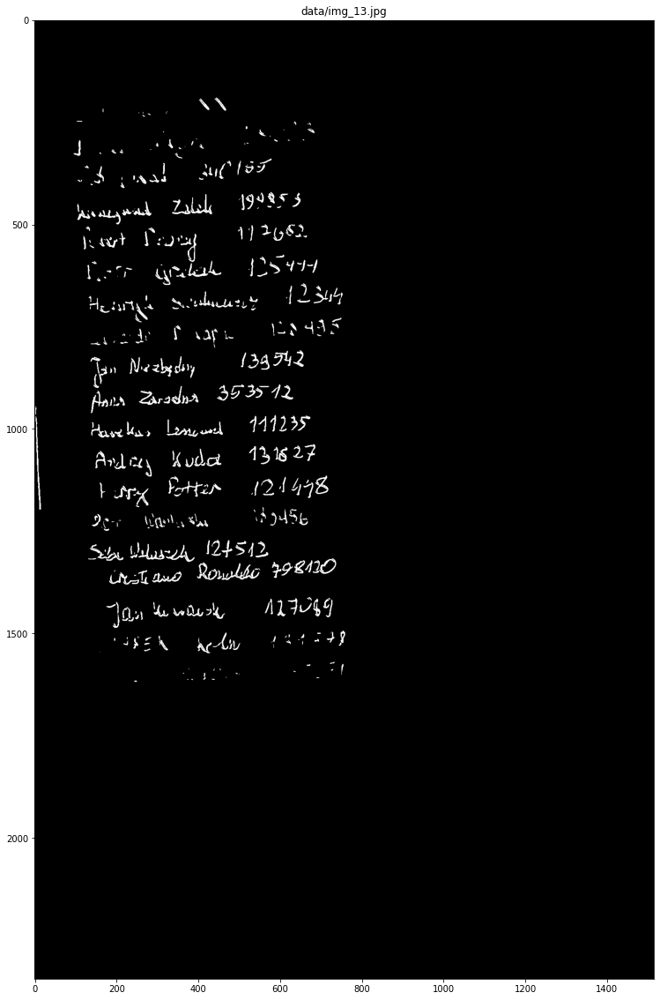

Took : 14.275s


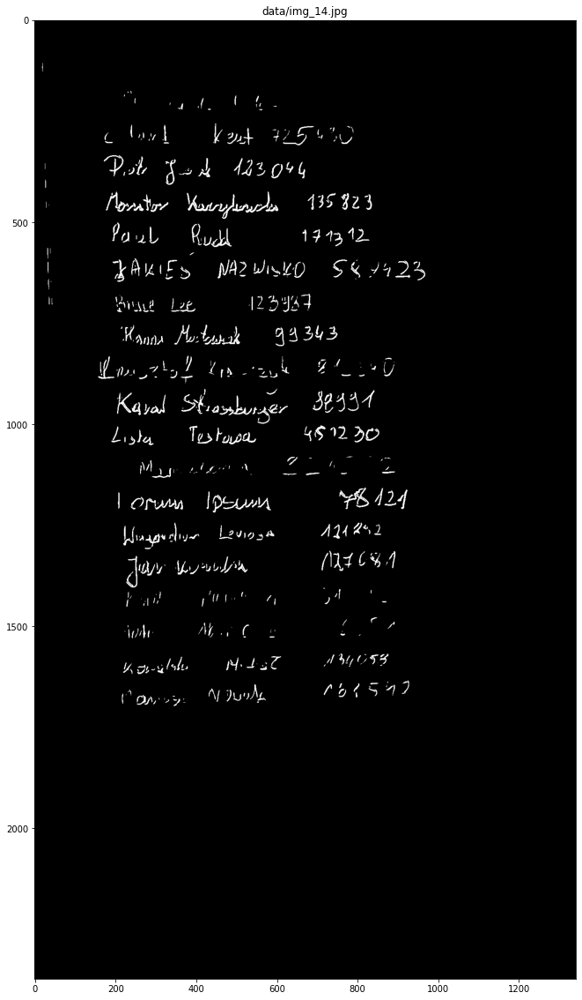

Took : 33.809s


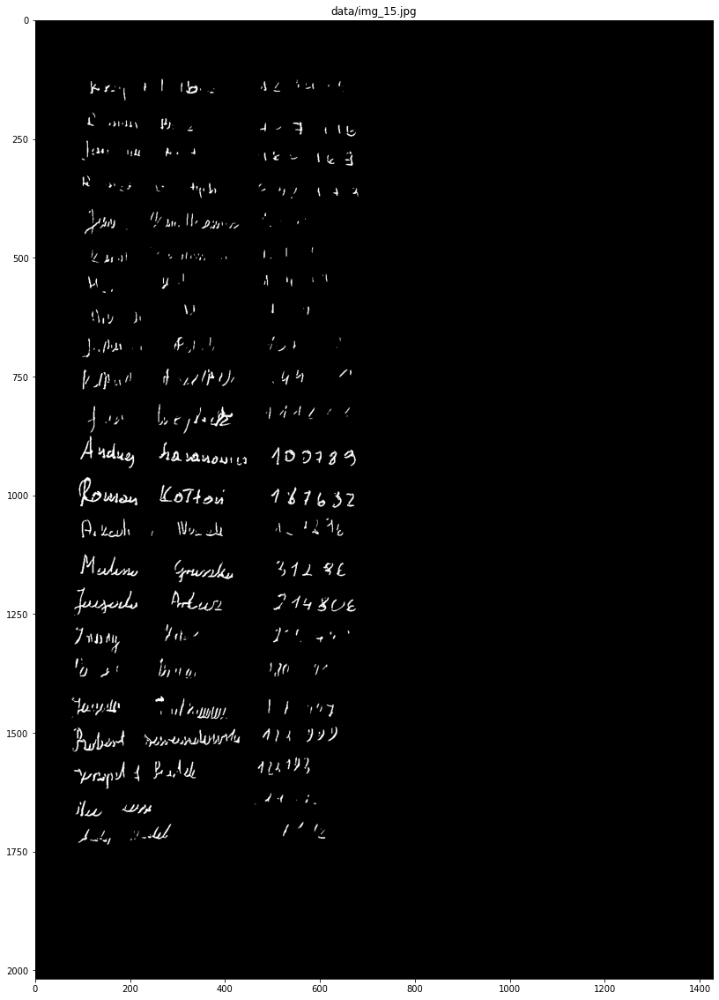

Took : 31.123s


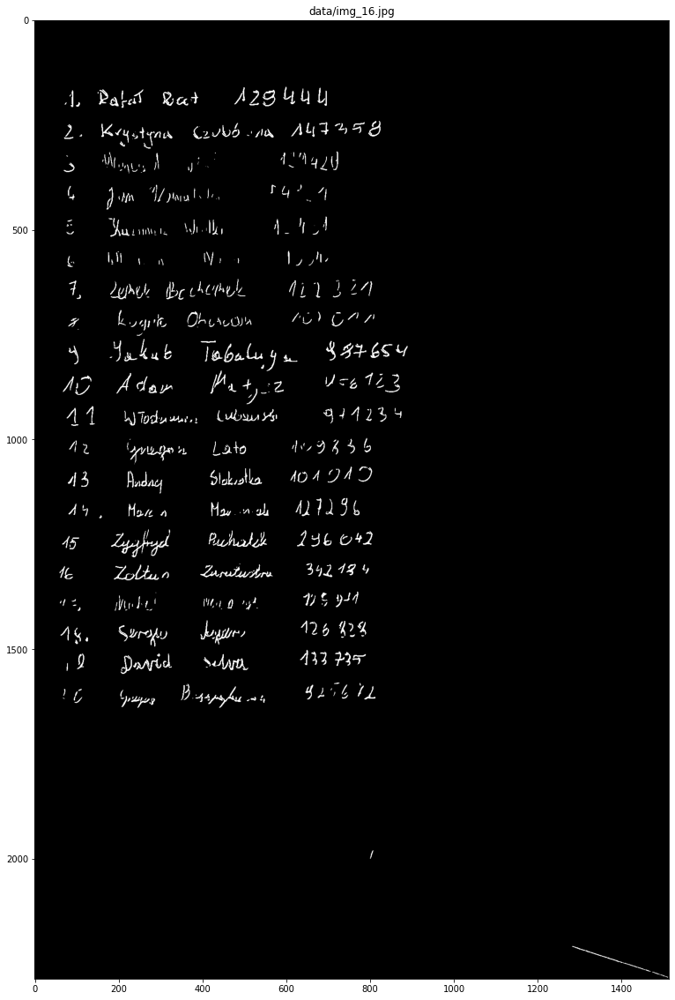

Took : 21.583s


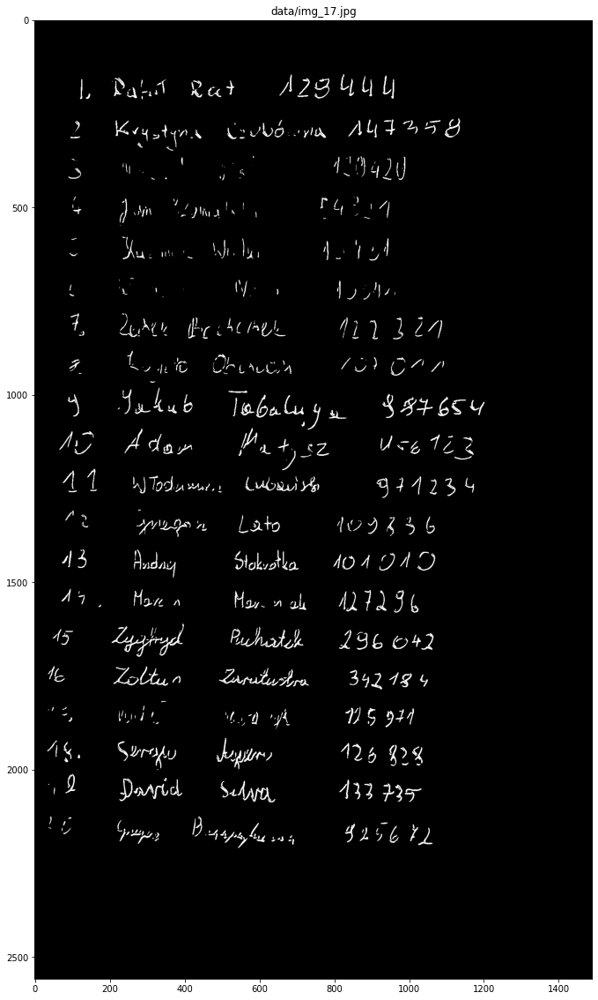

Took : 38.672s


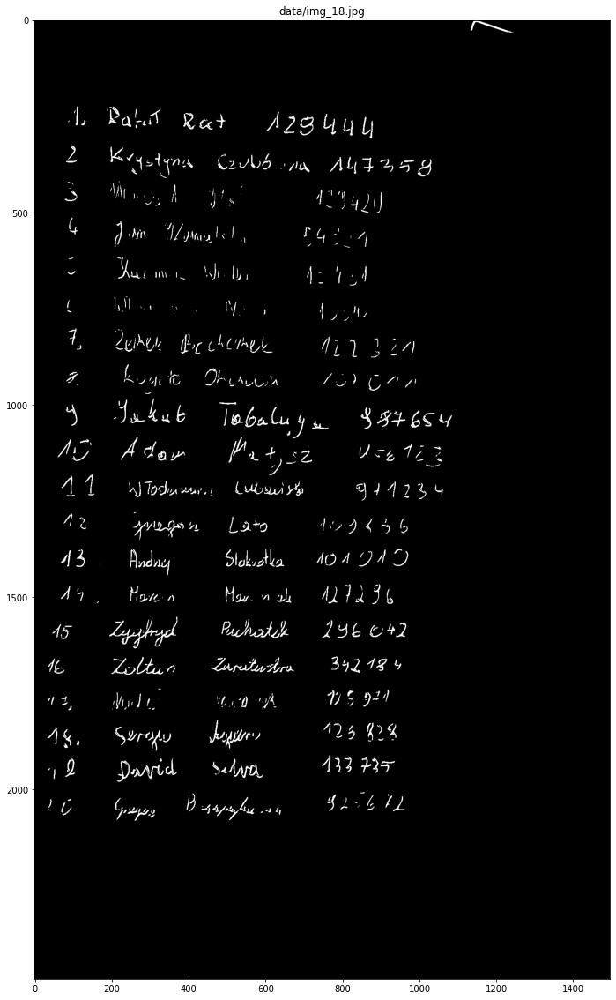

Took : 38.149s


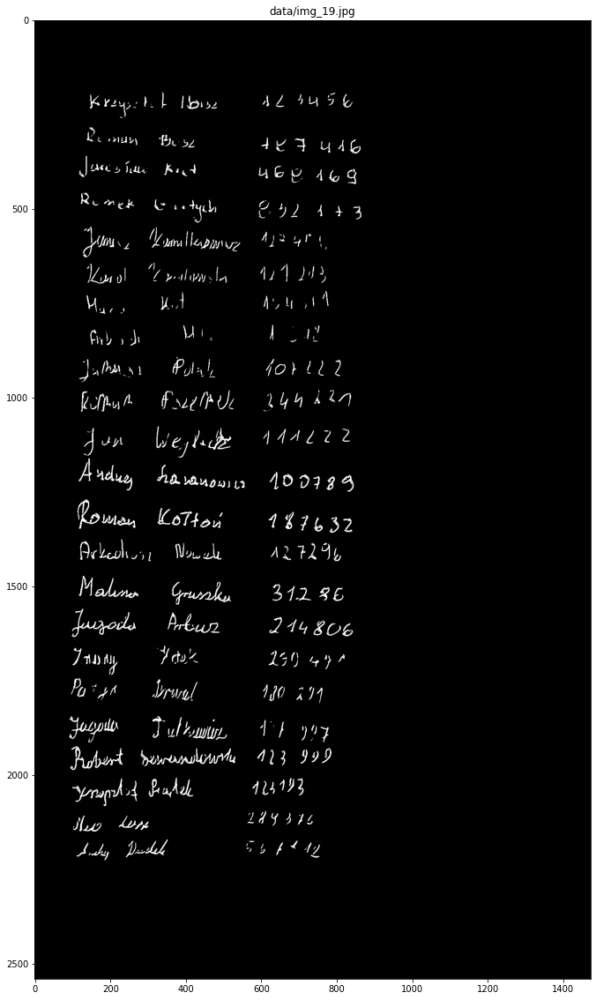

Took : 37.955s


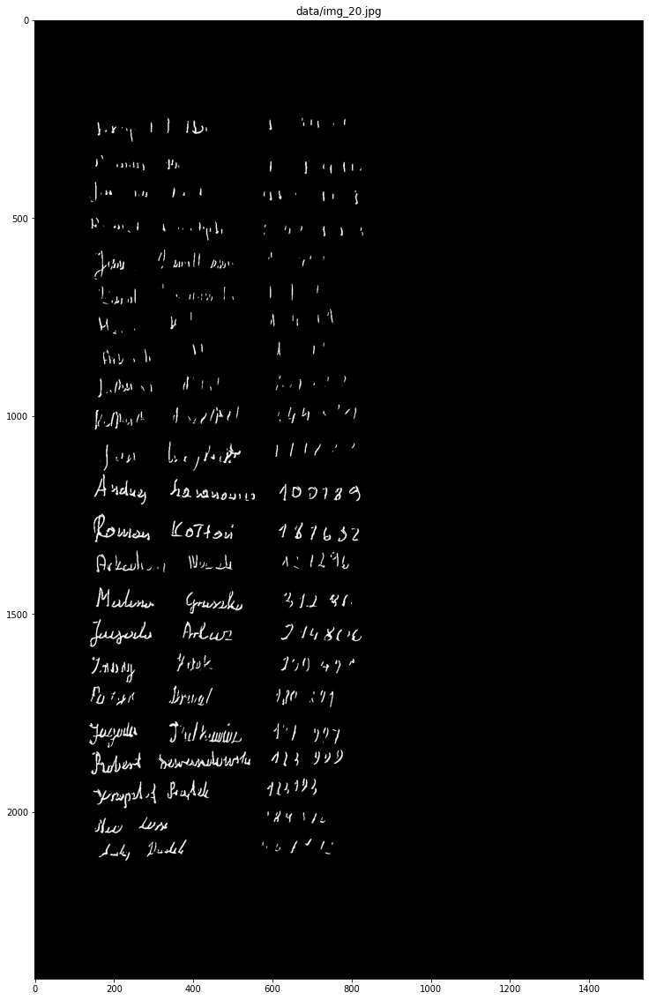

Took : 24.348s


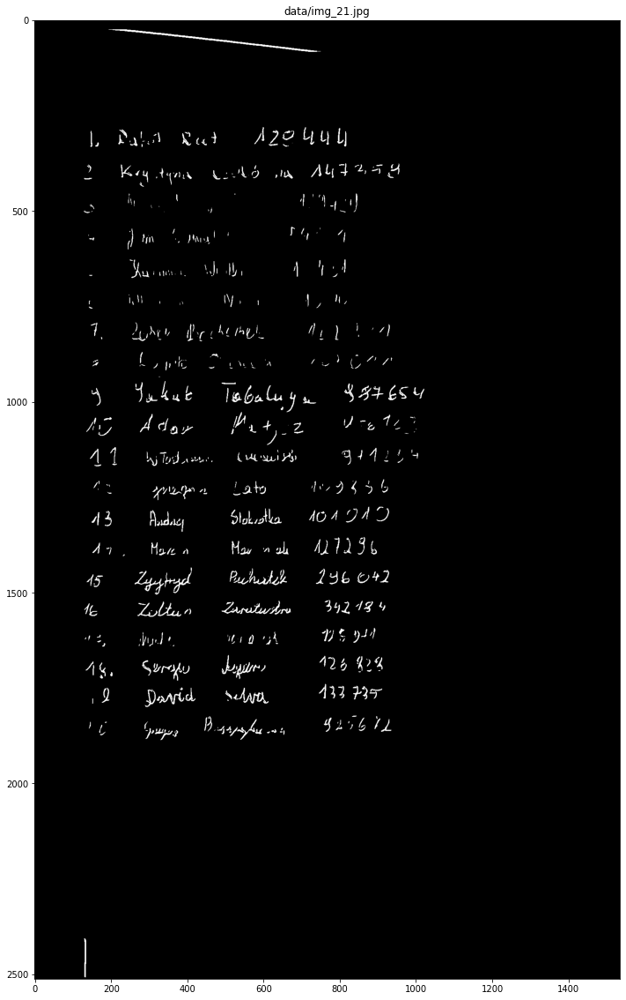

Took : 24.482s


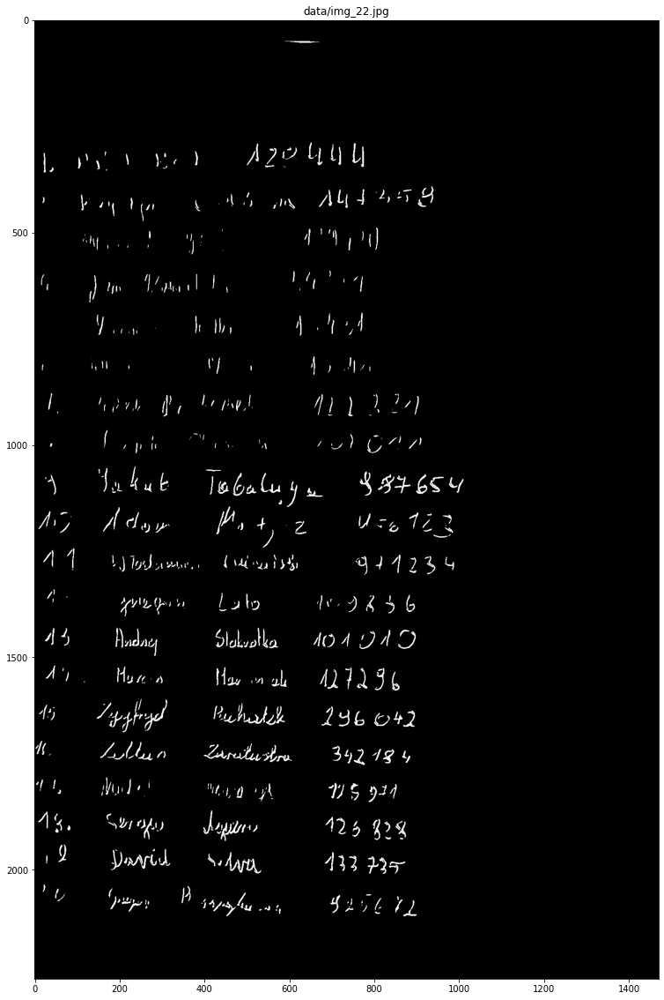

Took : 21.352s


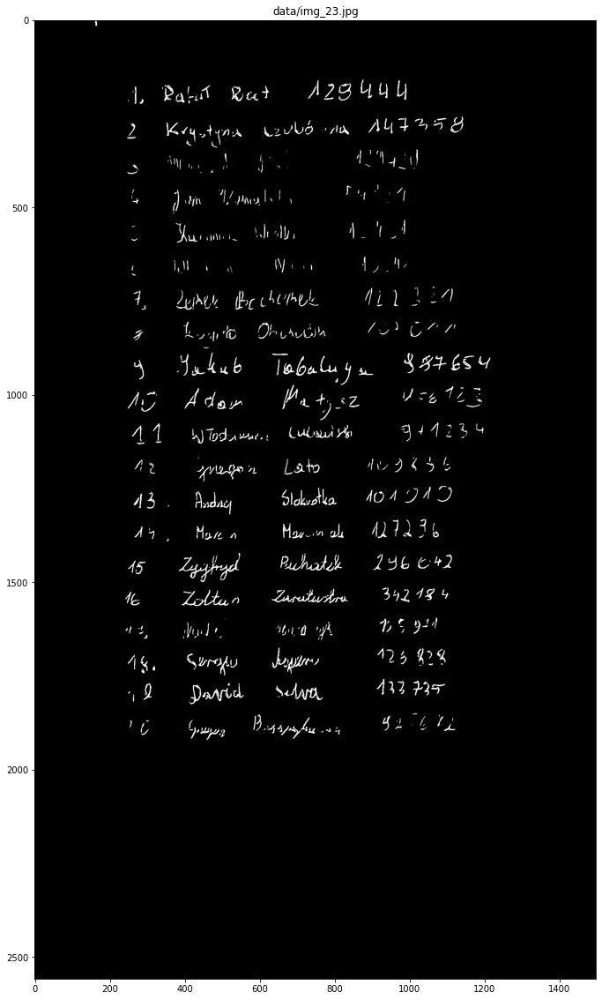

Took : 54.168s


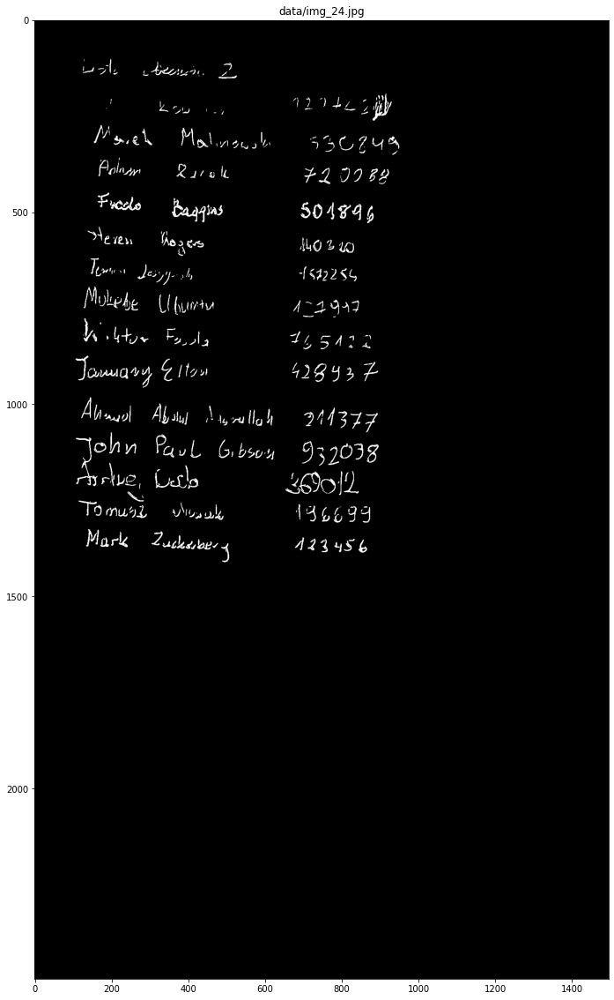

Took : 35.888s


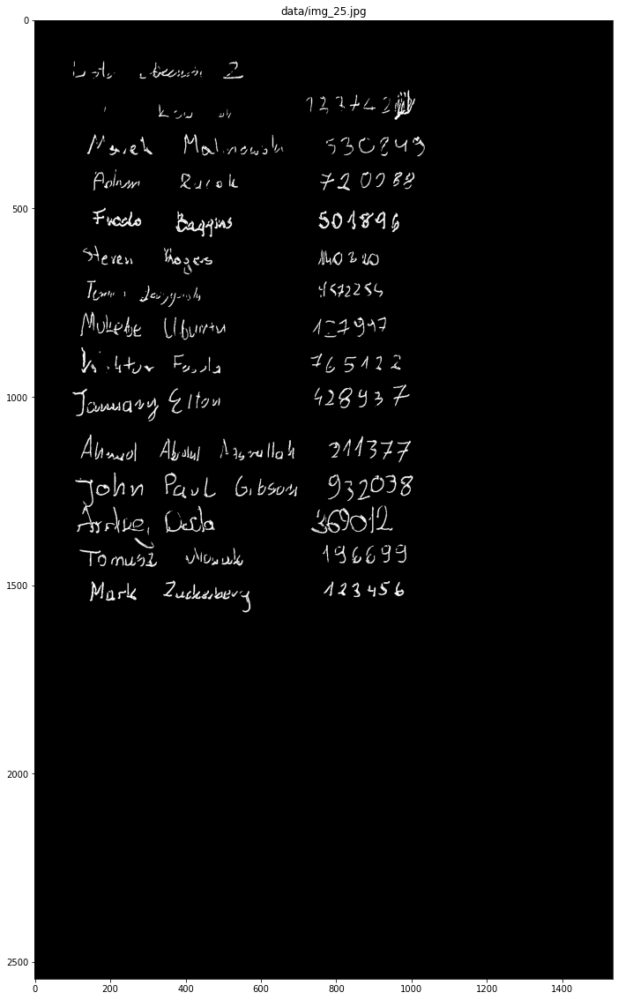

Took : 42.773s


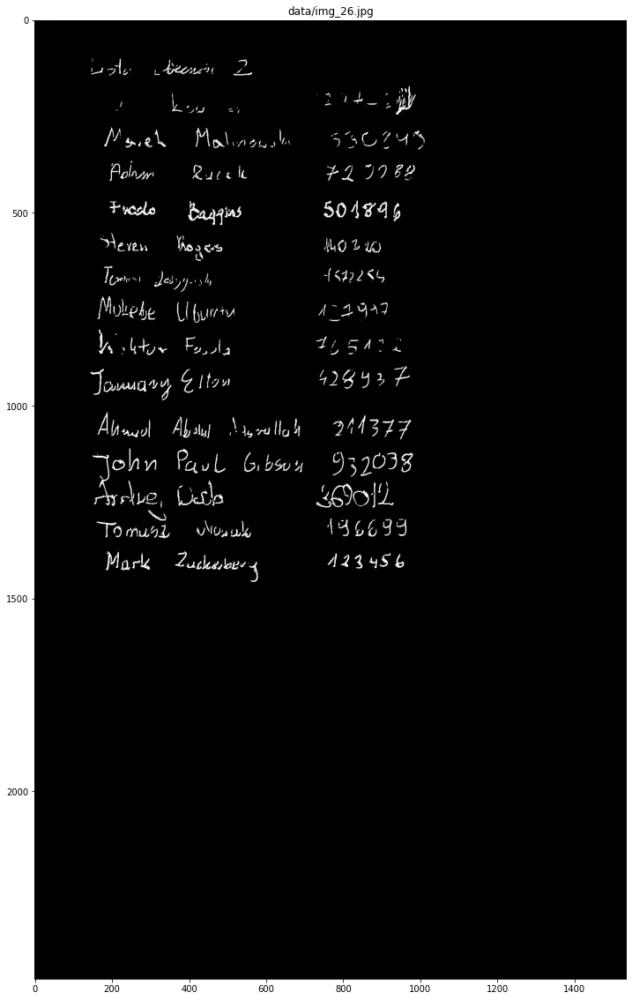

Took : 33.294s


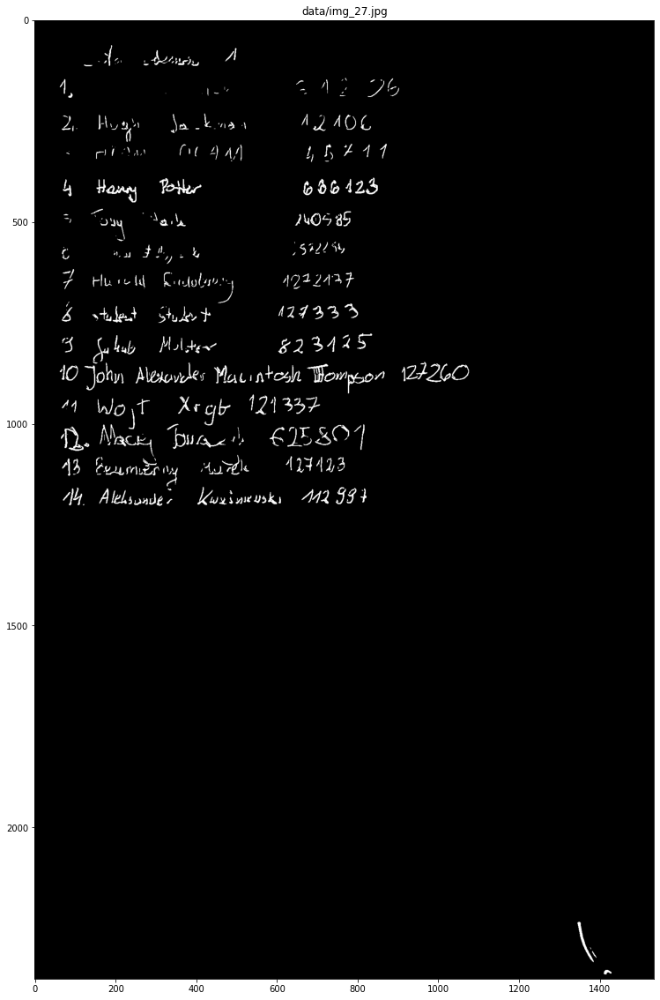

Took : 42.351s


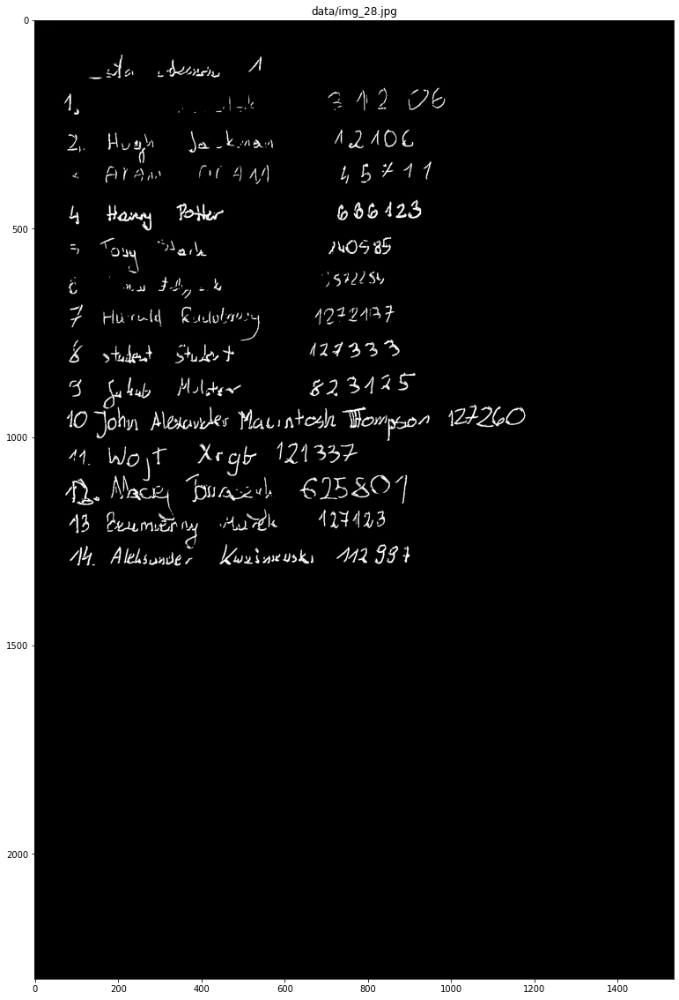

Took : 39.8s


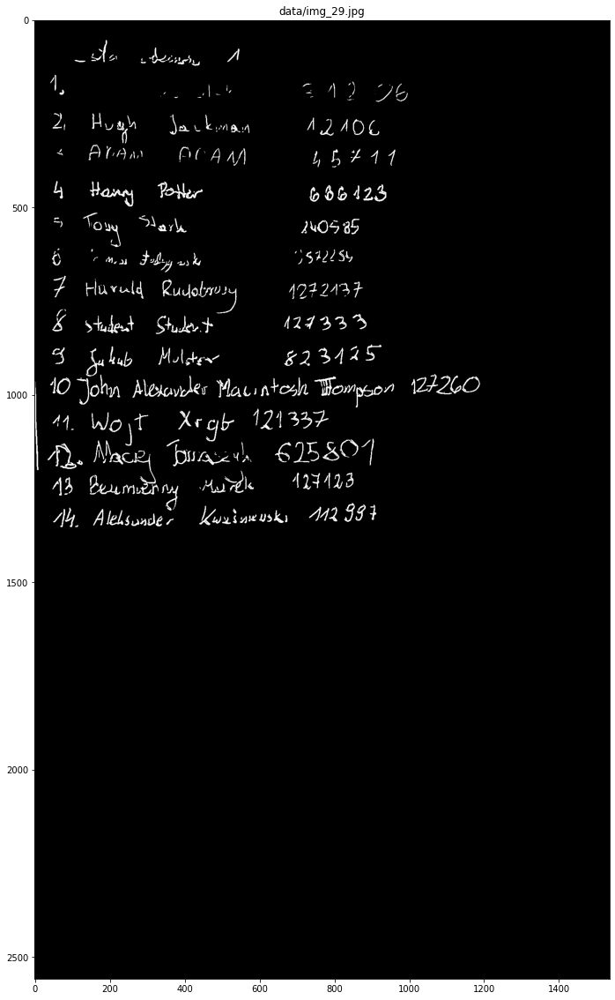

Took : 41.977s


In [30]:
from time import time

images_list = []
for i in range(1, 30):
    time_start = time()
    file_path = f'data/img_{i}.jpg'
    image = cv.imread(file_path, cv.IMREAD_GRAYSCALE)
    image_straightened = straighten_page(image)
    image_no_grid = remove_grid_lines(image_straightened)

    plt.figure(figsize=(20, 20))
    plt.title(file_path)
    plt.imshow(image_no_grid, cmap='gray')
    plt.show()
    duration = time() - time_start
    duration = round(duration, 3)
    print(f'Took : {duration}s')

    images_list.append(image_no_grid)

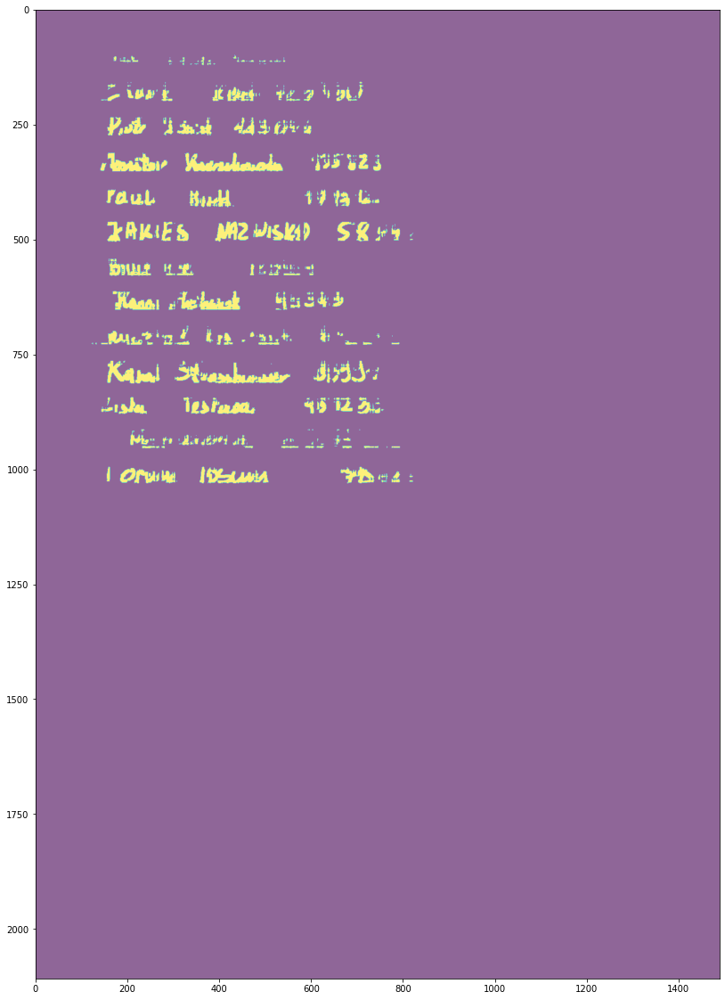

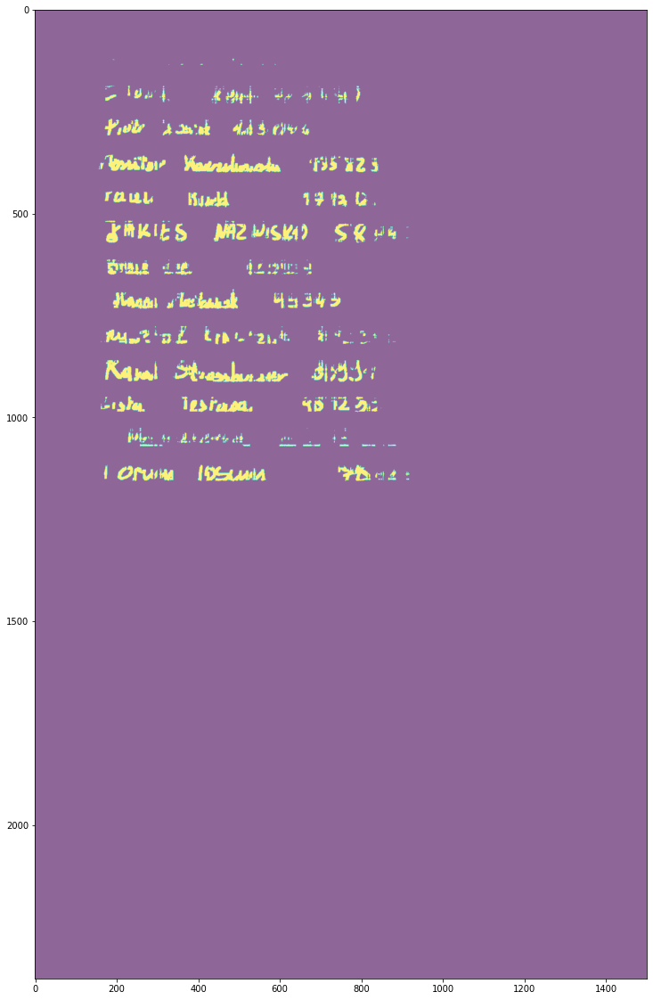

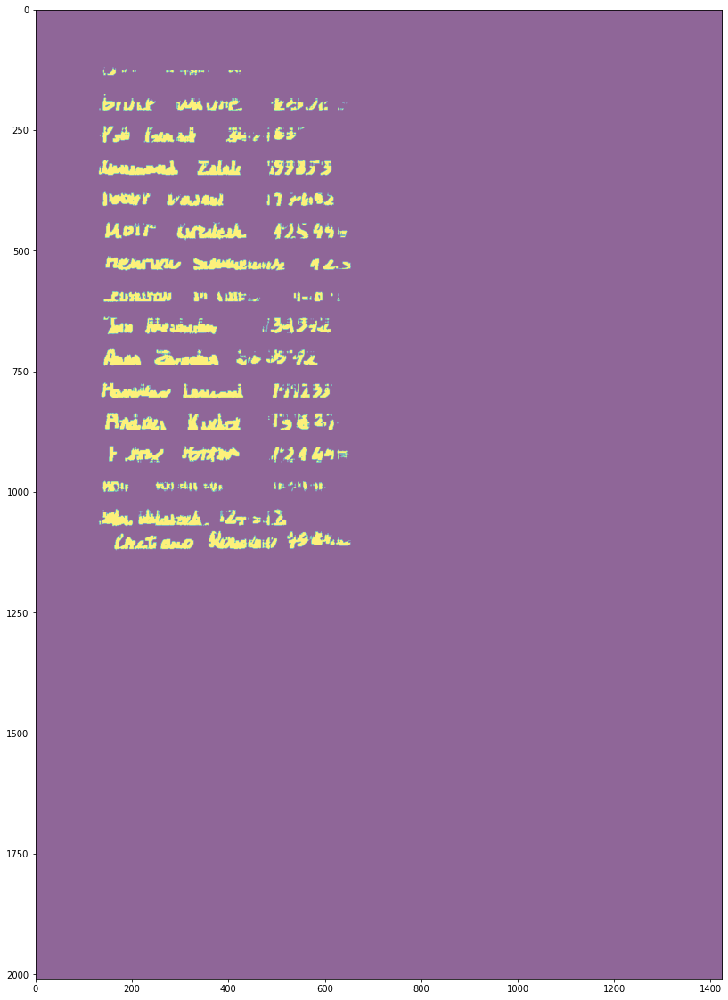

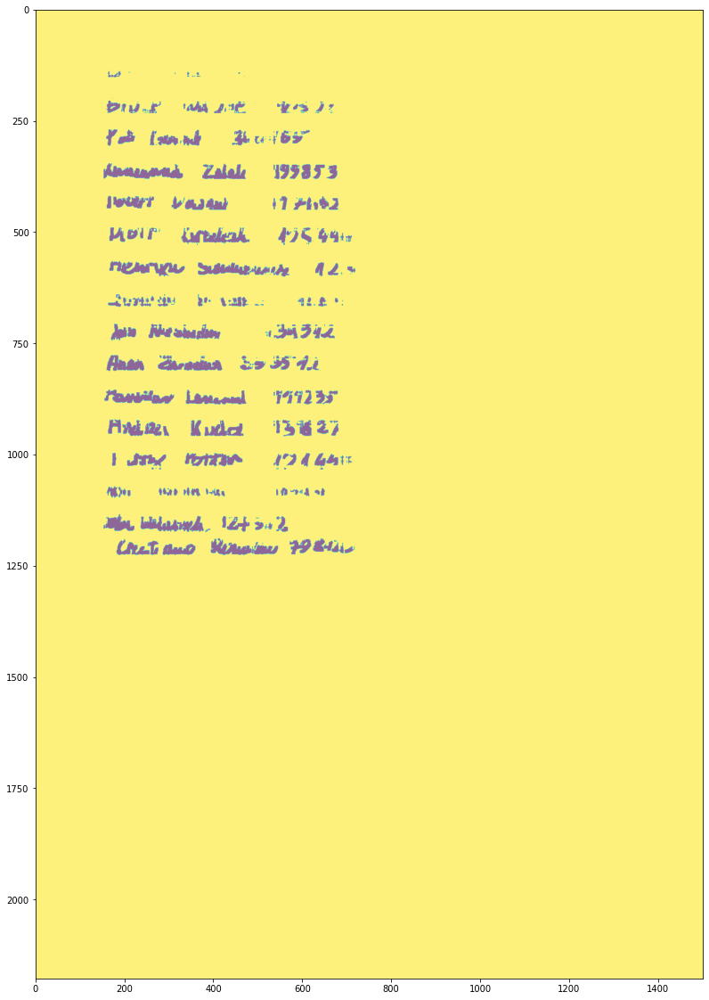

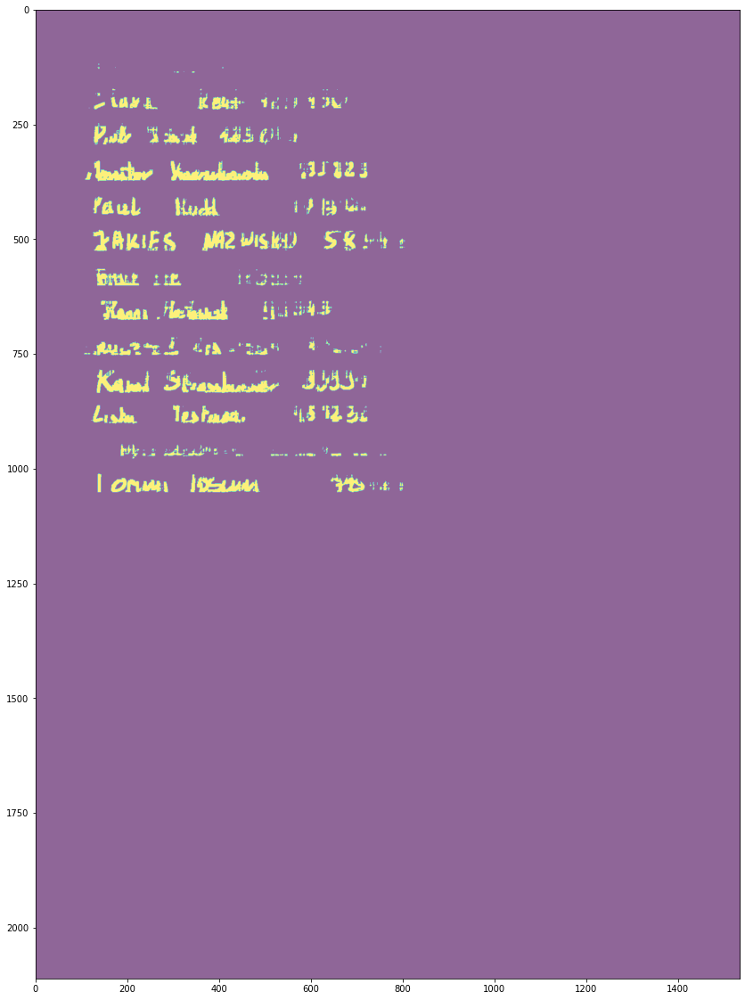

...

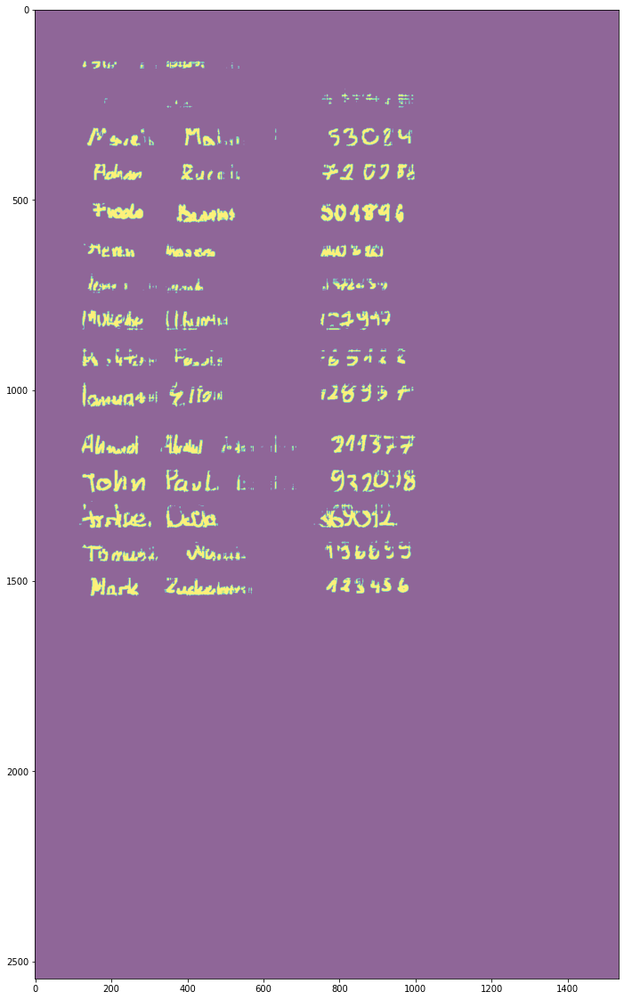

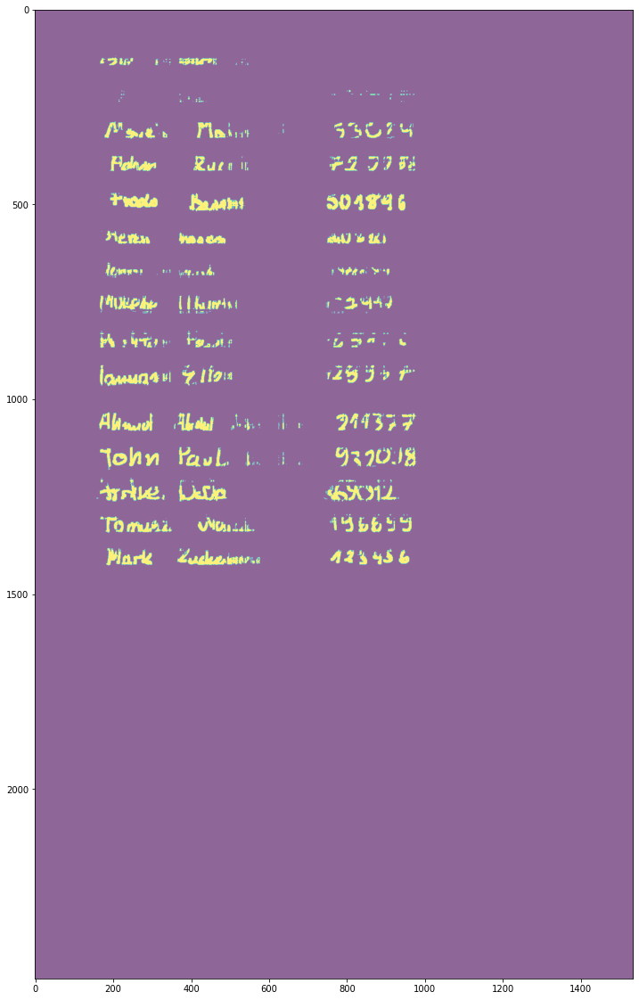

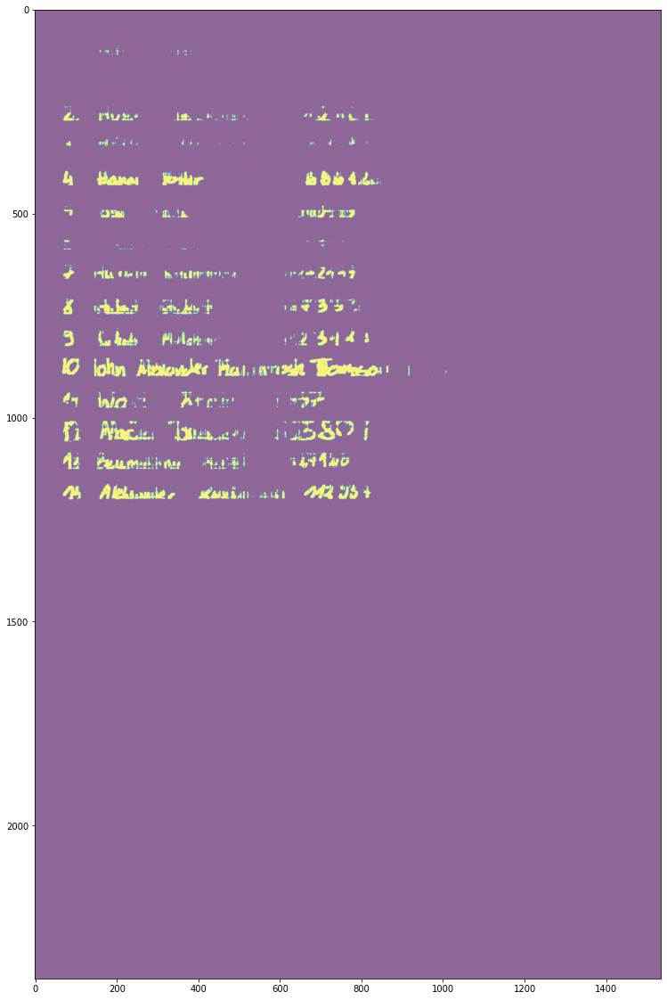

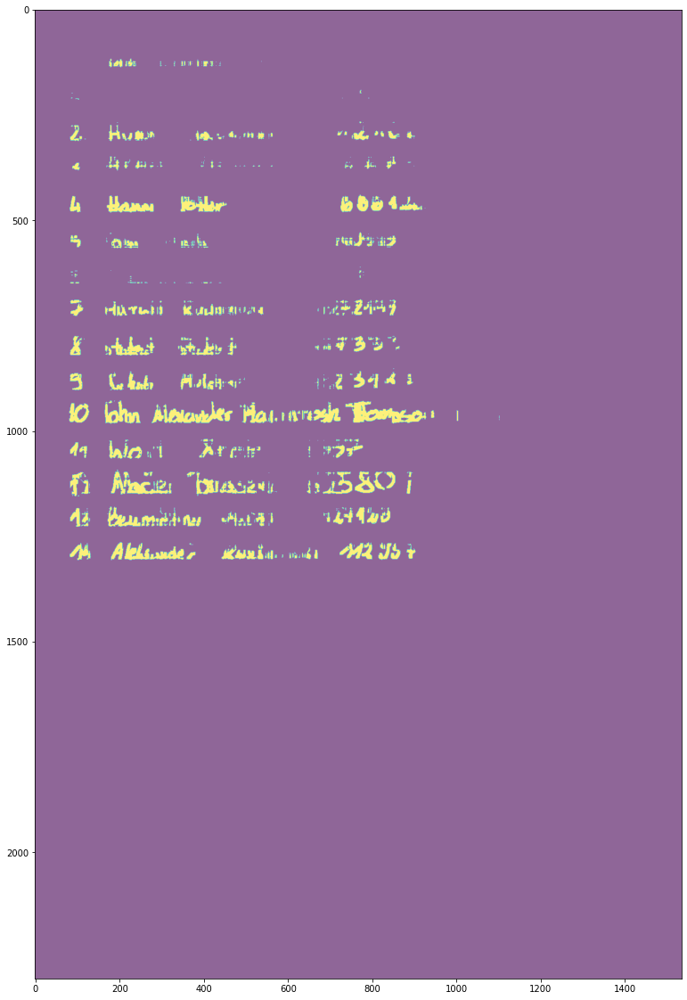

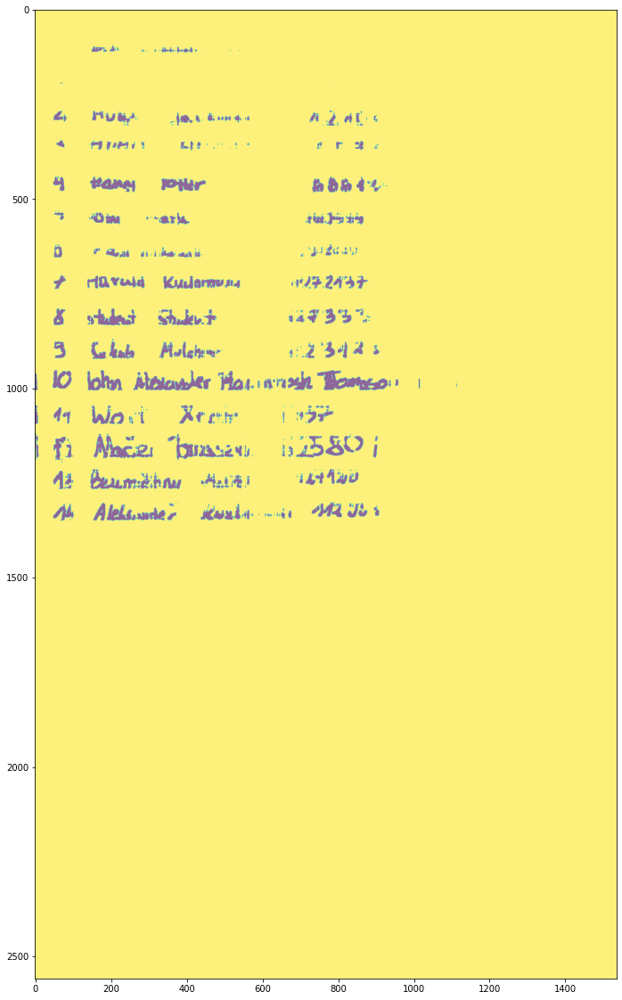

In [89]:
import numpy as np
from sklearn.cluster import KMeans
from scipy import ndimage

for i, image_no_grid in enumerate(images_list):
    plt.figure(figsize=(20, 20))
    row_pixels = np.sum(image_no_grid, axis=1)
    col_pixels = np.sum(image_no_grid, axis=0)


    height, width = image_no_grid.shape
    mask_rows = np.array([[r for _ in range(width)] for r in row_pixels])
    mask_cols = np.array([col_pixels for _ in range(height)])
    mask_comp = mask_rows * mask_cols * ndimage.convolve(image_no_grid, [
        [1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1],
    ])

    c = KMeans(2).fit_predict(mask_comp.reshape(-1, 1))

    mask_clusters = c.reshape(mask_comp.shape)
    mask_clusters = dilation(mask_clusters, square(1))

    plt.imshow(mask_clusters, alpha=0.6)
    plt.show()

    images_list[i] = [image_no_grid, mask_clusters]

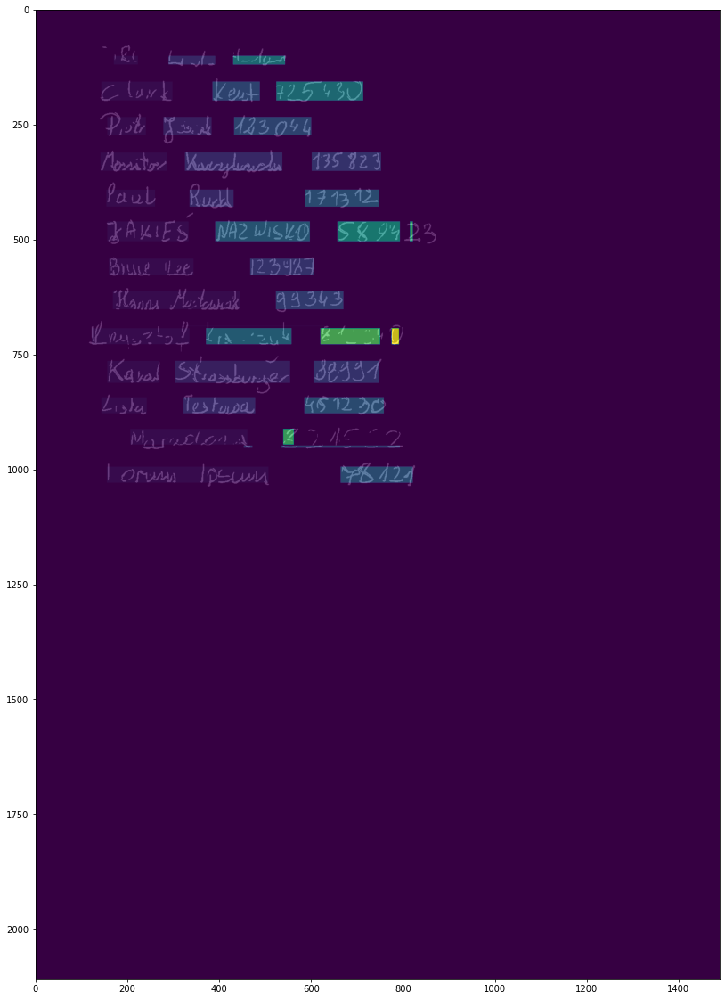

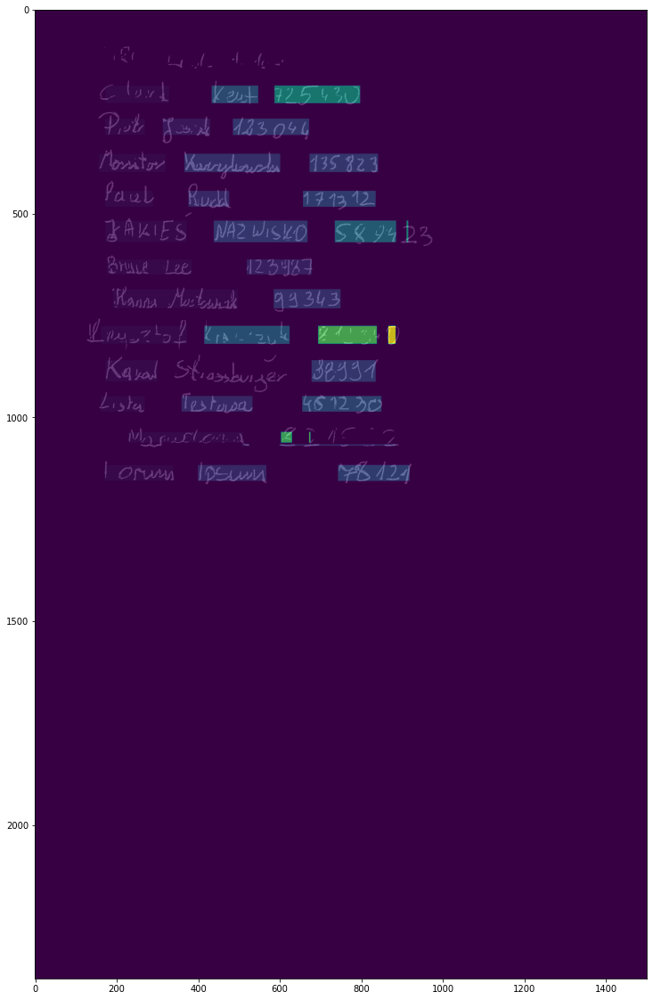

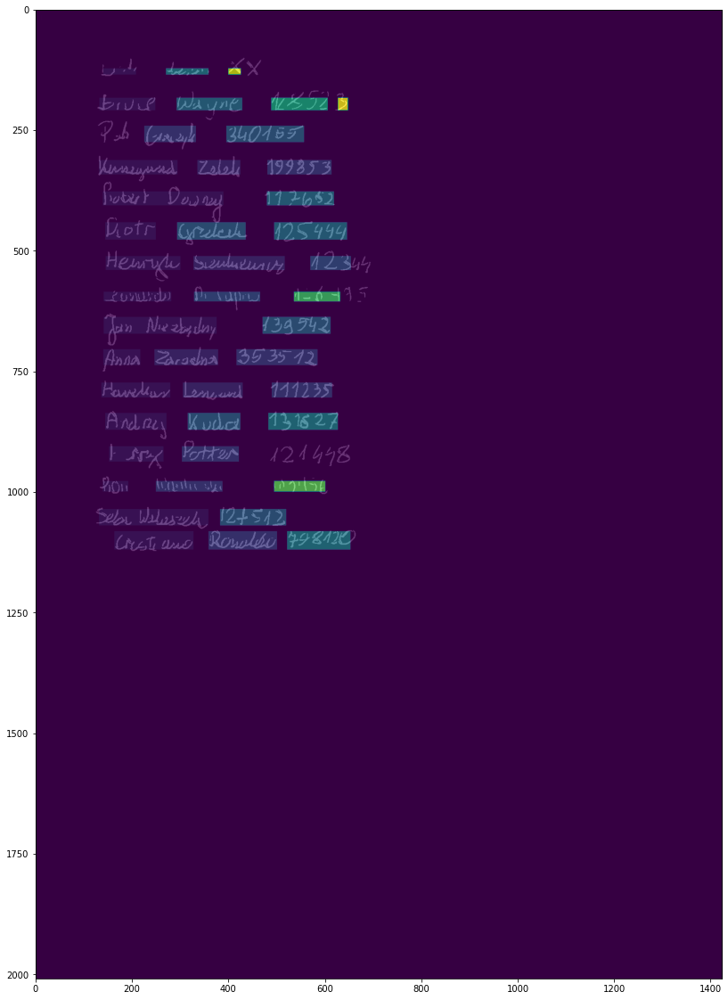

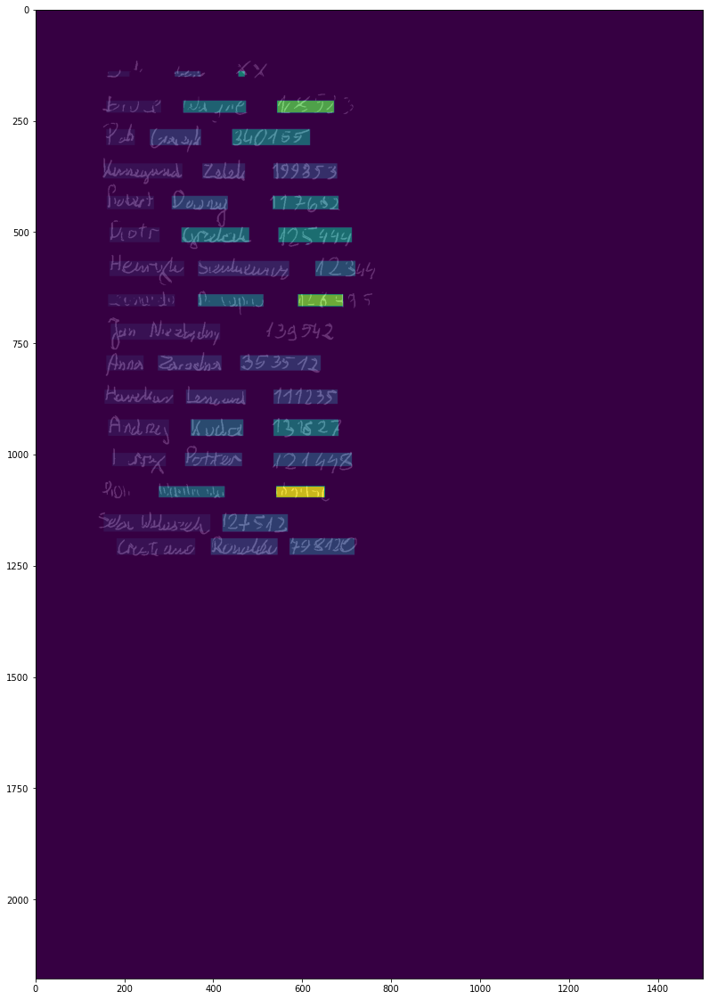

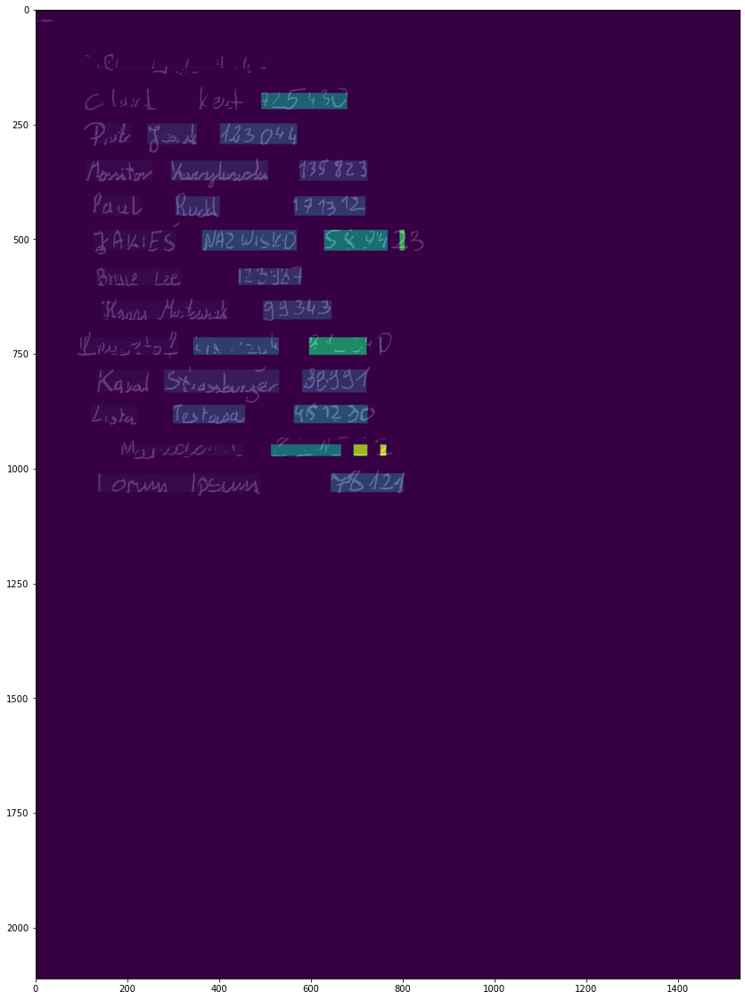

...

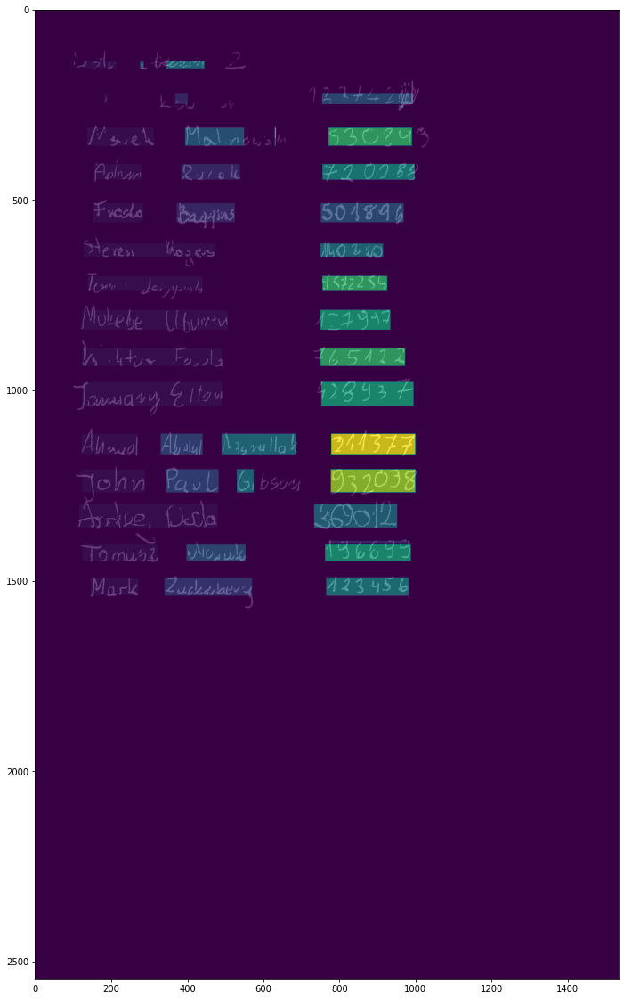

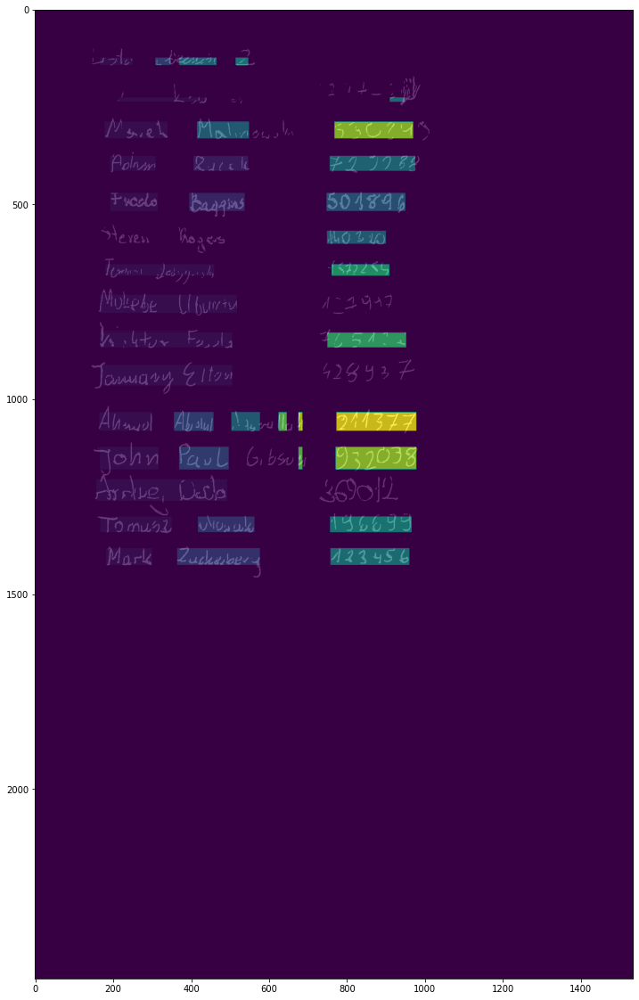

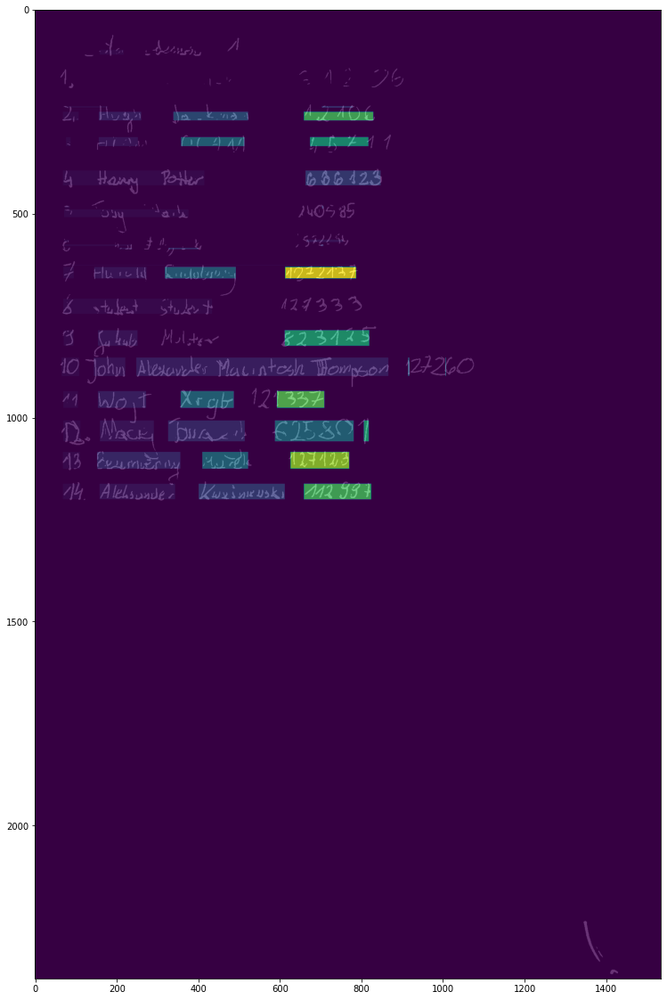

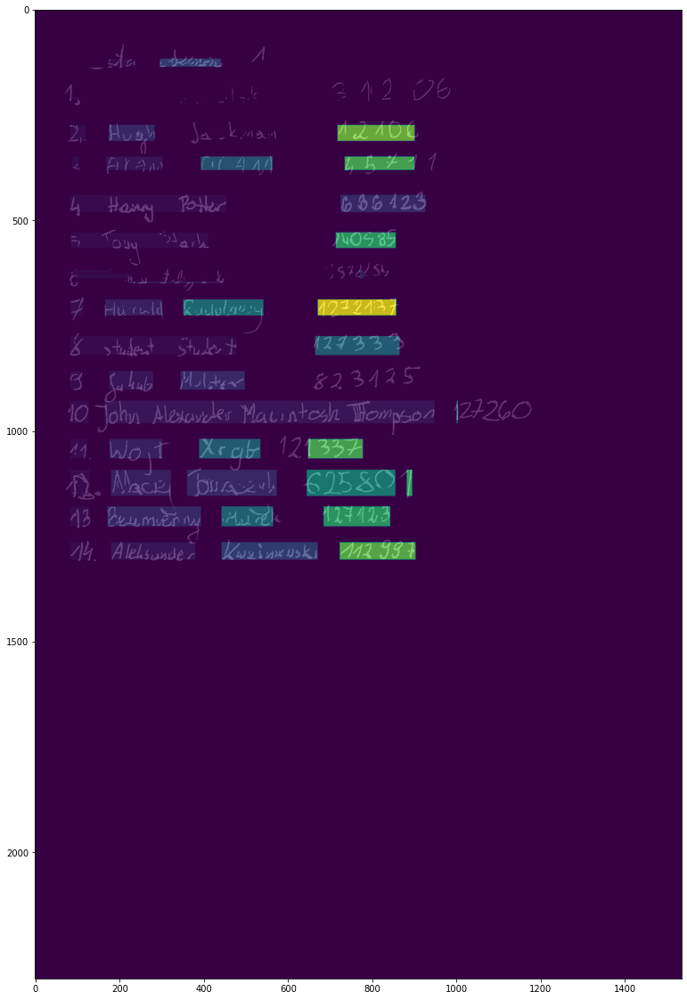

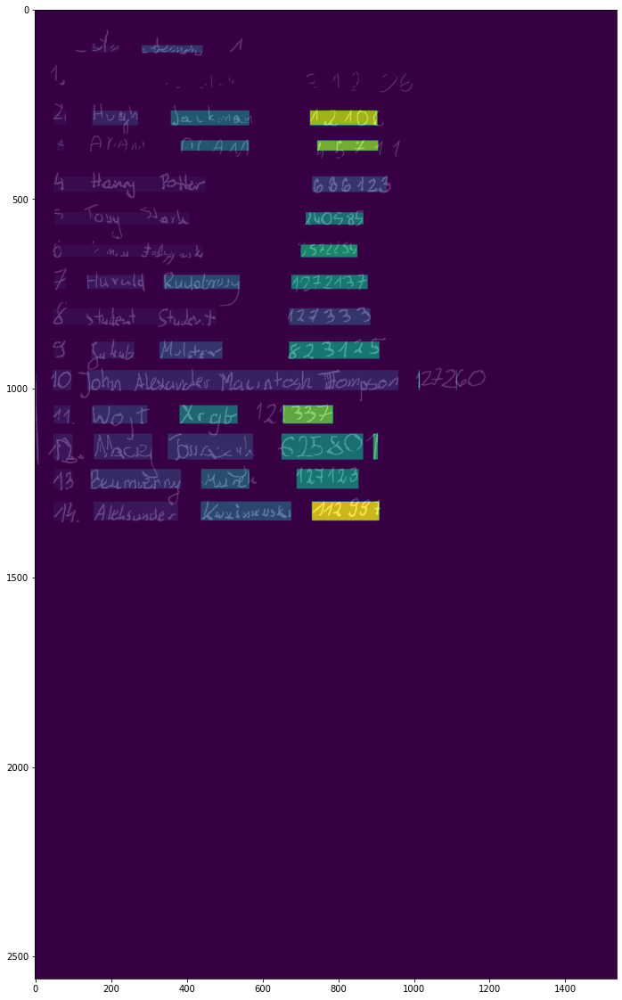

In [96]:
from collections import Counter
from skimage.morphology import dilation, square
from sklearn.metrics.pairwise import cosine_similarity

prepared_rows_per_img = []
for (image_no_grid, mask_clusters) in images_list:
    plt.figure(figsize=(20, 20))
    
    background_cluster = Counter(mask_clusters.flatten()).most_common(1)[0][0]
    marker_cluster = 1 - background_cluster

    def find_groups(matrix):
        group, marked = [], []
        for num, dim in enumerate(matrix):
            if np.any(dim == marker_cluster):
                group.append(num)
            elif len(group):
                marked.append(group)
                group = []

        lines_mask = np.zeros_like(matrix)
        for i, g in enumerate(marked, 1):
            a, b = g[0], g[-1]
            lines_mask[a:b] = i

        return lines_mask, marked

    def similarity(x, y):
        if x < y:
            x, y = y, x

        sim = cosine_similarity([[x, y]], [[y, x]])
        return sim[0][0]

    rows, marked_rows = find_groups(mask_clusters)
    for g in marked_rows:
        row_segments = []

        a, b = g[0], g[-1]
        clipped = mask_clusters[a:b]
        cols, marked_cols = find_groups(clipped.T)
        if len(marked_cols):
            try:
                breaks = [(col_beg[0] - col_end[-1]) for col_end, col_beg in zip(marked_cols, marked_cols[1:])]
                max_connection_cols = np.max(breaks)
                min_connection_cols = np.min(breaks)

                for col_a, col_b in zip(marked_cols, marked_cols[1:]):
                    segments_distance = col_b[0] - col_a[-1]
                    segment_a_width = col_a[-1] - col_a[0]
                    segment_b_width = col_b[-1] - col_b[0]

                    distance_similarity_max = similarity(max_connection_cols, segments_distance)
                    distance_similarity_min = similarity(min_connection_cols, segments_distance)
                        
                    if distance_similarity_max < 0.6 or distance_similarity_min > 0.2:
                        group_value = cols[col_a[-1] - 1][0]
                        cols[col_a[-1]:col_b[-1]+1] = group_value

                rows[a:b] = cols.T
            except Exception as e:
                rows[a:b] = background_cluster
        else:
            rows[a:b] = background_cluster

    plt.imshow(image_no_grid, cmap='gray')
    plt.imshow(rows, alpha=0.8)
    plt.show()

    prepared_rows_per_img.append(rows)

Przycinanie cyfr dbscanem

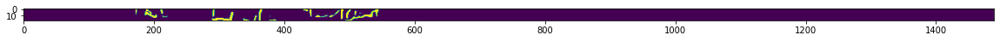

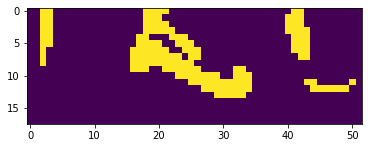

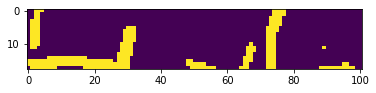

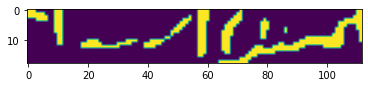

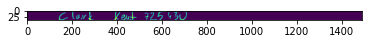

...

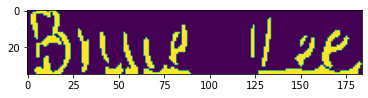

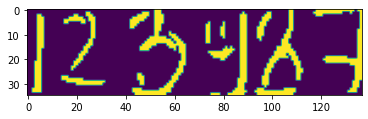

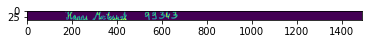

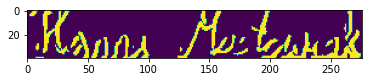

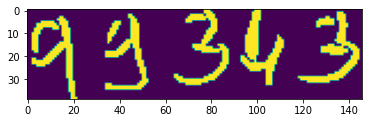

<ipython-input-164-3961f4bfae16>:47: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(r['data'])


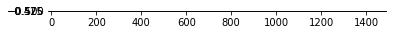

<ipython-input-164-3961f4bfae16>:51: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  plt.imshow(c['data'])


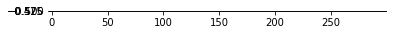

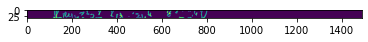

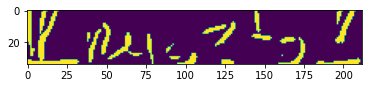

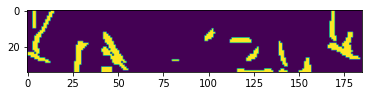

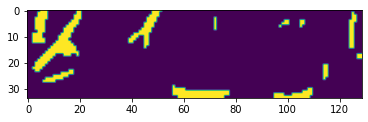

...

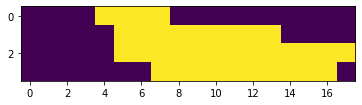

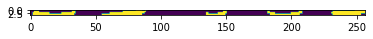

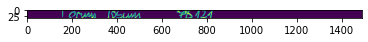

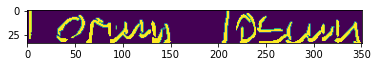

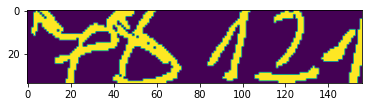

In [164]:
plt.figure(figsize=(20, 20))

def extract_all_segments(img, rows_mask):
    # powtarzanie tego co wyzej
    def find_segments(matrix):
        group, marked = [], []
        for num, dim in enumerate(matrix):
            if np.any(dim != marker_cluster):
                group.append(num)
            elif len(group):
                marked.append({
                    'data': matrix[group],
                    'from': group[0],
                    'to': group[-1]
                })
                group = []

        return marked

    all_rows = []
    rows = find_segments(rows_mask)
    for r in rows:
        cols_in_row = find_segments(r['data'].T)
        all_cols = []

        for c in cols_in_row:
            fragment = img[r['from']:r['to'], c['from']:c['to']]
            all_cols.append({
                'data': fragment,
                'from': c['from'],
                'to': c['to']
            })

        fragment = img[r['from']:r['to']]
        all_rows.append({
            'data': fragment,
            'from': r['from'],
            'to': r['to'],
            'cols': all_cols
        })
        
    return all_rows
        

rows = extract_all_segments(images_list[0][0], prepared_rows_per_img[0])
for r in rows:
    plt.imshow(r['data'])
    plt.show()

    for c in r['cols']:
        plt.imshow(c['data'])
        plt.show()

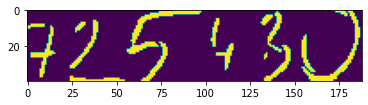

In [189]:
from skimage.morphology import closing
number = rows[1]['cols'][-1]['data']
plt.imshow(number)

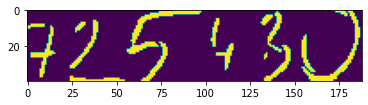

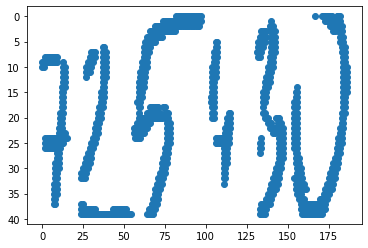

labels [-1  0  1  2  3  4  5  6]


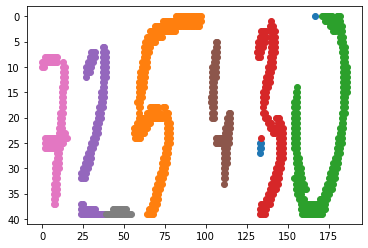

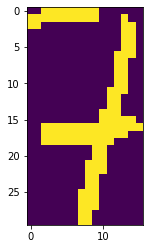

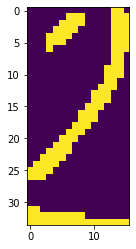

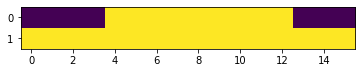

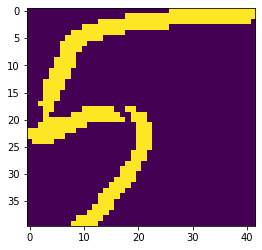

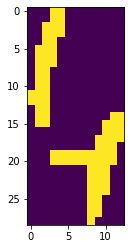

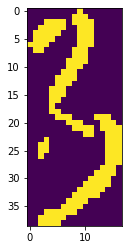

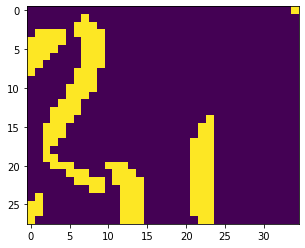

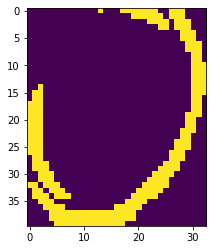

In [190]:
from sklearn.cluster import DBSCAN

bw = number

plt.imshow(bw)
plt.show()

non_zero_y, non_zero_x = np.where(bw > 0)
non_zero = np.array(list(zip(non_zero_x, non_zero_y)))
plt.scatter(non_zero[:, 0], non_zero[:, 1])
plt.gca().invert_yaxis()
plt.show()

digits_coord = []
dbsc = DBSCAN(min_samples=15, eps=5)
dbsc.fit(non_zero)
print("labels", np.unique(dbsc.labels_))
for label in np.unique(dbsc.labels_):
    points = non_zero[np.where(dbsc.labels_ == label)]
    plt.scatter(points[:, 0], points[:, 1])
    digits_coord.append((min(points[:, 1]), max(points[:, 1] + 1), min(points[:, 0]), max(points[:, 0]) + 1))
plt.gca().invert_yaxis()
plt.show()

biggest_group = max(digits_coord, key=lambda x: abs(x[0]-x[1])*abs(x[2]-x[3]))

digits_coord.sort(key=lambda x: x[2])

digits = []
for d in digits_coord:
    digits.append(bw[d[0]:d[1], d[2]:d[3]])

for d in digits:
    plt.imshow(d)
    plt.show()


Upodobnienie obrazów cyfr do obrazów z klasyfikatora mnist (skalowanie oraz dodanie czarnego obramowania)

In [188]:
from cv2 import resize, INTER_AREA, copyMakeBorder, BORDER_CONSTANT, dilate
import math

for i in range(len(digits)):
    d = digits[i]

    d_height, d_width = d.shape

    d_proportion = d_width / d_height
    sample_size = 28
    border_size = 8
    max_size = sample_size - border_size

    if d_width > d_height:
        d = resize(d, (max_size, int(max_size * d_proportion)), interpolation=INTER_AREA)
    else:
        d = resize(d, (int(max_size * d_proportion), max_size), interpolation=INTER_AREA)

    border_vertical = (sample_size - d.shape[0]) / 2
    border_verticalT = math.ceil((sample_size - d.shape[0]) / 2)
    border_verticalB = math.floor((sample_size - d.shape[0]) / 2)

    border_horizontal = (sample_size - d.shape[1]) / 2
    border_horizontalL = math.ceil(border_horizontal)
    border_horizontalR = math.floor(border_horizontal)

    d = copyMakeBorder(d, border_verticalT, border_verticalB, border_horizontalL, border_horizontalR, BORDER_CONSTANT)

    kernel = np.ones((2, 2), np.uint8)
    d = dilate(d, kernel, iterations=1)

    # print(d.shape)
    digits[i] = d

error: OpenCV(4.5.1) /tmp/pip-req-build-ms668fyv/opencv/modules/core/src/copy.cpp:1445: error: (-215:Assertion failed) top >= 0 && bottom >= 0 && left >= 0 && right >= 0 && _src.dims() <= 2 in function 'copyMakeBorder'


Uczenie klasyfikatora SVM na zbiorze danych mnist (lub wczytanie go z pliku)

In [191]:
import os
import pickle
from sklearn.datasets import fetch_openml
from sklearn.svm import SVC

dataset_pickle_path = "dataset_mnist.pickle"
clf_pickle_path = "clf_mnist.pickle"

if not os.path.isfile(dataset_pickle_path):
    X, y = data = fetch_openml('mnist_784', version=1, return_X_y=True, as_frame=False)
    with open(dataset_pickle_path, 'wb') as f:
        pickle.dump(data, f)
else:
    with open(dataset_pickle_path, 'rb') as f:
        X, y = pickle.load(f)

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

if not os.path.isfile(clf_pickle_path):
    clf = SVC()
    clf.fit(X, y)
    with open(clf_pickle_path, 'wb') as f:
        pickle.dump(clf, f)
else:
    with open(clf_pickle_path, 'rb') as f:
        clf = pickle.load(f)

# y_pred = clf.predict(X_test)
# print(accuracy_score(y_test, y_pred))

FileNotFoundError: [Errno 2] No such file or directory: '../pickled_objects/dataset_mnist.pickle'

Podgląd przetworzonych cyfr oraz cyfr ze zbioru mnist

In [ ]:
plt.imshow(bw)
plt.show()

for d in digits:
    plt.imshow(d)
    plt.show()

#
# for i in range(10):
#     plt.imshow(X[i].reshape(28,28))
#     plt.show()

reshaped = np.array([d.reshape(784) for d in digits])
print(clf.predict(reshaped))